***I. IMPORT DATA AND PREPARATION***

1.1 SUMMARY OF THE DATASET:

https://huggingface.co/datasets/disaster_response_messages

Dataset Summary

This dataset contains 30,000 messages drawn from events including an earthquake in Haiti in 2010, an earthquake in Chile in 2010, floods in Pakistan in 2010, super-storm Sandy in the U.S.A. in 2012, and news articles spanning a large number of years and 100s of different disasters. The data has been encoded with 36 different categories related to disaster response and has been stripped of messages with sensitive information in their entirety. Upon release, this is the featured dataset of a new Udacity course on Data Science and the AI4ALL summer school and is especially utile for text analytics and natural language processing (NLP) tasks and models.The input data in this job contains thousands of untranslated disaster-related messages and their English translations. In the “Data” tab above, you’ll find the annotated data, with 40 class labels for intent and content.

Supported Tasks and Leaderboards

The input data in this job contains thousands of untranslated disaster-related messages and their English translations. In the dataset, you’ll find the annotated data, with 40 class labels for intent and content. This dataset contains the original message in its original language, the English translation, and dozens of classes for message content. These classes are noted in column titles with a simple binary 1= yes, 0=no.


Languages

The dataset is a multilingual dataset which has the messages in the original language and also it's translated English form.

Data Fields

- split: Train, Test split
- message: English text of actual messages related to disaster
- original: Text of column 3 in native language as originally written
- genre: Type of message, including direct messages, social posting, and news stories or bulletins
- related: Is the message disaster related? 1= yes, 0=no, 2=maybe
- PII: Does the message contain PII? 1= yes, 0=no
- request: Does the message contain a request? 1= yes, 0=no
- offer: Does the message contain an offer? 1= yes, 0=no
- aid_related: Is the message aid related? 1= yes, 0=no
- medical_help: Does the message concern medical help? 1= yes, 0=no
- medical_products: Does the message concern medical products? 1= yes, 0=no
- search_and_rescue: Does the message concern search and rescue? 1= yes, 0=no
- security: Does the message concern security? 1= yes, 0=no
- military: Does the message concern military? 1= yes, 0=no
- child_alone: Does the message mention a child alone? 1= yes, 0=no
- water: Does the message concern water? 1= yes, 0=no
- food: Does the message concern food? 1= yes, 0=no
- shelter: Does the message concern shelter? 1= yes, 0=no
- clothing: Does the message concern clothing? 1= yes, 0=no
- money: Does the message concern money? 1= yes, 0=no
- missing_people: Does the message indicate missing people? 1= yes, 0=no
- refugees: Does the message concern refugess? 1= yes, 0=no
- death: Does the message imply death? 1= yes, 0=no
- other_aid: Is there any other aid needed? 1=yes, 0=no
- infrastructure_related: Does the message concern infrastructure? 1= yes, 0=no
- transport: Does the message concern transport? 1= yes, 0=no
- buildings: Does the message concern buildings? 1= yes, 0=no
- electricity: Does the message concern electricity? 1= yes, 0=no
- tools: Does the message concern tools? 1= yes, 0=no
- hospitals: Does the message concern clothing? 1= yes, 0=no
- shops: Does the message concern clothing? 1= yes, 0=no
- aid_centers:Does the message concern clothing? 1= yes, 0=no
- other_infrastructure:Does the message concern clothing? 1= yes, 0=no
- weather_related: Does the message concern weather? 1= yes, 0=no
- floods: Does the message indicate there was a flood? 1= yes, 0=no
- storm: Does the message indicate there was a storm? 1= yes, 0=no
- fire: Does the message indicate there was a fire? 1= yes, 0=no
- earthquake: Does the message indicate there was an earthquake? 1= yes, 0=no
- cold: Does the message indicate there was a cold? 1= yes, 0=no
- other_weather: Does the message indicate there was other weather issues? 1= yes, 0=no
- direct_report: Does the show a direct report? 1= yes, 0=no

1.2. IMPORT PACKAGE AND PROCESS DATA

In [229]:
%pip install numpy

In [230]:
%pip install --upgrade threadpoolctl


  Using cached threadpoolctl-3.1.0-py3-none-any.whl (14 kB)
  Attempting uninstall: threadpoolctl
    Found existing installation: threadpoolctl 2.1.0
    Uninstalling threadpoolctl-2.1.0:
      Successfully uninstalled threadpoolctl-2.1.0
Note: you may need to restart the kernel to use updated packages.


In [231]:
%pip install pyldavis==2.1.2

  Using cached pyLDAvis-2.1.2-py2.py3-none-any.whl
  Attempting uninstall: pyldavis
    Found existing installation: pyLDAvis 3.4.0
    Uninstalling pyLDAvis-3.4.0:
      Successfully uninstalled pyLDAvis-3.4.0
Note: you may need to restart the kernel to use updated packages.


In [232]:
%pip install --upgrade pyldavis

  Using cached pyLDAvis-3.4.0-py3-none-any.whl (2.6 MB)
  Attempting uninstall: pyldavis
    Found existing installation: pyLDAvis 2.1.2
    Uninstalling pyLDAvis-2.1.2:
      Successfully uninstalled pyLDAvis-2.1.2
Note: you may need to restart the kernel to use updated packages.


In [233]:
%pip install openblas

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement openblas (from versions: none)
ERROR: No matching distribution found for openblas


In [234]:
%pip install gensim

Note: you may need to restart the kernel to use updated packages.


In [235]:
%pip install kneed

Note: you may need to restart the kernel to use updated packages.


In [236]:
%pip install keras

Note: you may need to restart the kernel to use updated packages.


In [237]:
%pip install tensorflow-cpu

Note: you may need to restart the kernel to use updated packages.


In [238]:
# from tensorflow import keras

In [239]:
%pip install squarify

Note: you may need to restart the kernel to use updated packages.


In [240]:
# %pip install torch

In [241]:
%pip install --upgrade --force-reinstall threadpoolctl

  Using cached threadpoolctl-3.1.0-py3-none-any.whl (14 kB)
  Attempting uninstall: threadpoolctl
    Found existing installation: threadpoolctl 3.1.0
    Uninstalling threadpoolctl-3.1.0:
      Successfully uninstalled threadpoolctl-3.1.0
Note: you may need to restart the kernel to use updated packages.


In [242]:
pip install --upgrade threadpoolctl

Note: you may need to restart the kernel to use updated packages.


In [243]:
%pip install umap-learn

Note: you may need to restart the kernel to use updated packages.


In [244]:
%pip install threadpoolctl==2.1.0

  Using cached threadpoolctl-2.1.0-py3-none-any.whl (12 kB)
  Attempting uninstall: threadpoolctl
    Found existing installation: threadpoolctl 3.1.0
    Uninstalling threadpoolctl-3.1.0:
      Successfully uninstalled threadpoolctl-3.1.0
Note: you may need to restart the kernel to use updated packages.


In [245]:
%pip install numpy pillow matplotlib

In [246]:
# %pip install wordcloud matplotlib ipykernel

In [247]:
# %pip install wordcloud

In [248]:
# %pip install wordcloud

In [249]:
%pip install scipy

Note: you may need to restart the kernel to use updated packages.


In [250]:
%pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [251]:
# %pip install sklearn
# %pip install -U scikit-learn

In [252]:
%pip install lime shap

Note: you may need to restart the kernel to use updated packages.


In [253]:
%pip install numpy

Note: you may need to restart the kernel to use updated packages.


In [254]:
%pip install pandas

Note: you may need to restart the kernel to use updated packages.


In [255]:
# %pip install plotly

In [256]:
%pip install spacy

Note: you may need to restart the kernel to use updated packages.


In [257]:
%pip install nltk

Note: you may need to restart the kernel to use updated packages.


In [258]:
%pip download wordcloud

  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\wordcloud-1.8.2.2-cp310-cp310-win_amd64.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\Pillow-9.5.0-cp310-cp310-win_amd64.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\matplotlib-3.7.1-cp310-cp310-win_amd64.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\numpy-1.24.2-cp310-cp310-win_amd64.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\pyparsing-3.0.9-py3-none-any.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\kiwisolver-1.4.4-cp310-cp310-win_amd64.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\fonttools-4.39.3-py3-none-any.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\cycler-0.11.0-py3-none-any.whl
  File was already downloaded d:\du_hoc\lecture\nlp\project\disaster\packaging-23.1-py3-none-any.whl
  File was already downloaded d:\du_hoc\l

In [259]:
import sys
print(sys.executable)

c:\Users\buith\anaconda3\python.exe


In [260]:
# %pip install wordcloud


In [261]:
# %pip install --upgrade --force-reinstall wordcloud

In [262]:
%pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [263]:
%pip install pyqt5

Note: you may need to restart the kernel to use updated packages.


In [264]:
import matplotlib
matplotlib.use('Qt5Agg')

In [265]:
import matplotlib.pyplot as plt

In [266]:
import numpy as np
import pandas as pd

In [267]:
import scipy

In [268]:
import string
import spacy

In [269]:
import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn import metrics

In [270]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize
from nltk.corpus import stopwords
from nltk.corpus import wordnet
from nltk import pos_tag
from nltk import ne_chunk

from nltk.stem.porter import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer


In [271]:
import re

In [272]:
%pip install datasets

In [273]:
%python -m spacy download en_core_web_md

UsageError: Line magic function `%python` not found (But cell magic `%%python` exists, did you mean that instead?).


In [274]:
%pip install openai

Note: you may need to restart the kernel to use updated packages.


In [275]:
import openai

In [276]:
from datasets import DatasetDict
from collections import defaultdict

from datasets import load_dataset

In [277]:
# import plotly
from openai.embeddings_utils import get_embedding, cosine_similarity

In [278]:
import datasets
from datasets import load_dataset

In [279]:
%pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


In [280]:
import yellowbrick

In [281]:
# %pip install --upgrade threadpoolctl
# %pip install --upgrade scikit-learn

In [282]:
# !git clone "https://github.com/GeorgeMcIntire/fake_real_news_dataset"

In [283]:
# data=pd.read_csv('https://raw.githubusercontent.com/GeorgeMcIntire/fake_real_news_dataset/main/fake_and_real_news_dataset.csv')

In [284]:
# data= load_dataset("disaster_response_messages")

In [285]:
# train=data['train']

In [286]:
# validation=data['validation']

In [287]:
# test=data['test']

In [288]:
# df_train=train.to_pandas()

In [289]:
# df_test=test.to_pandas()

In [290]:
# df_valid=validation.to_pandas()

In [291]:
df_train=pd.read_csv("disaster_response_messages_training.csv")

Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.


In [292]:
df_test=pd.read_csv("disaster_response_messages_test.csv")

In [293]:
df_valid=pd.read_csv("disaster_response_messages_validation.csv")

In [294]:
df_train.drop(['original'],axis=1,inplace=True)
df_test.drop(['original'],axis=1,inplace=True)
df_valid.drop(['original'],axis=1,inplace=True)

In [295]:
df_train

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,0,1,0,1,0,0,0,0,0
2,12,train,"says: west side of Haiti, rest of the country ...",direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,14,train,Information about the National Palace-,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,15,train,Storm at sacred heart of jesus,direct,1,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21041,30261,train,The training demonstrated how to enhance micro...,news,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
21042,30262,train,A suitable candidate has been selected and OCH...,news,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
21043,30263,train,"Proshika, operating in Cox's Bazar municipalit...",news,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
21044,30264,train,"Some 2,000 women protesting against the conduc...",news,1,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [296]:
df_test

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,9,test,UN reports Leogane 80-90 destroyed. Only Hospi...,direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,39,test,We are at Gressier we needs assistance right a...,direct,1,0,1,0,1,1,...,0,0,1,1,0,0,0,0,0,1
2,49,test,"Delmas 33 in Silo, need water.",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,79,test,"SOS SOS, please provide police officers on the...",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1
4,99,test,"I am a driver, a mechanic ,. I want to help",direct,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2624,30189,test,"UNHCR ($653,000) is supplying basic non-food i...",news,1,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
2625,30209,test,One of the first organizations to respond to t...,news,1,0,0,0,1,0,...,0,0,1,1,0,0,0,0,0,0
2626,30239,test,The President said that her Government always ...,news,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2627,30249,test,Following the severe floods which occurred ove...,news,1,0,0,0,0,0,...,0,0,1,1,0,0,0,0,0,0


In [297]:
df_valid

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,8,validation,Looking for someone but no name,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,18,validation,I am in Croix-des-Bouquets. We have health iss...,direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,1
2,28,validation,are you going to call me or do you want me to ...,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,38,validation,"People I'm at Delma 2, we don't anything what ...",direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,1
4,48,validation,How we can find food and water? we have people...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2568,30218,validation,"""With more than 7,500 people infected already ...",news,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0
2569,30228,validation,About 70 percent of China's rivers and lakes a...,news,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2570,30238,validation,Senegal and Guinea-Bissau have agreed to condu...,news,1,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2571,30248,validation,WHO is recruiting a sanitary engineer / consul...,news,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [298]:
df_train=df_train.applymap(str)
df_valid=df_valid.applymap(str)
df_test=df_test.applymap(str)

In [299]:
def join_words(words_list):
    return ' '.join(words_list)

In [300]:
#Set up stop words for removal
import nltk
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')

nltk.download('stopwords')
from nltk.corpus import stopwords
#stopwords
stop_words=stopwords.words("english")


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\buith\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\buith\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\buith\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [301]:
list_of_stop_words=["the", "has", "it", "with", "were", "can", "of","to","on", "this", "about", "that","was", "also", "http", "are","is", "am","some", "about","a", "an", "which", "what", "how", "when", "who","this","that","are", "the", "to", "we", "have", "in", "you", "with", "of", "what", "be", "as", "has", "from", "by", "that", "am","people","know","dont","also","would","people","please","like","would","People","Know","need","Need","Also","Like","Would","Dont","take","make","tell","well","many","Many","want","Want","cause","still","since","give","year","include","problem","place","region","number","find","provide","come","can","could","may","might","area","affect","world","person","part","thank","thanks","haiti", "information", "good", "anything", "nothing", "time","help","country","report","can","cant","cannot","can not","along"]
stop_words.extend(list_of_stop_words)

In [302]:
def preprocess(x):
    x = re.sub('[^a-z\s]', '', x.lower())
    x = re.sub(r'\b\w{1,3}\b',' ',x)
    x = re.sub(r'\d+',' ', x)
    stop_words = list(stopwords.words('english'))
    stop_words.extend(list_of_stop_words)
    x = [w for w in x.split() if w not in stop_words]
    return ' '.join(x)

In [303]:
#mapping pos tags
def get_wordnet_pos(pos_tag):
    if pos_tag.startswith('J'):
        return wordnet.ADJ
    elif pos_tag.startswith('V'):
        return wordnet.VERB
    elif pos_tag.startswith('N'):
        return wordnet.NOUN
    elif pos_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [304]:
#lemmatizing 
import string

def clean_text(text):
    text = [word.strip(string.punctuation) for word in text.split()]
    pos_tags = pos_tag(text)
    lemmatizer = WordNetLemmatizer()
    text = [lemmatizer.lemmatize(t[0], get_wordnet_pos(t[1])) for t in pos_tags]
    text = " ".join(text)
    return(text)

In [305]:
df_train.head()

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,0,1,0,1,0,0,0,0,0
2,12,train,"says: west side of Haiti, rest of the country ...",direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,14,train,Information about the National Palace-,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,15,train,Storm at sacred heart of jesus,direct,1,0,0,0,0,0,...,0,0,1,0,1,0,0,0,0,0


In [306]:
df_test.head()

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,9,test,UN reports Leogane 80-90 destroyed. Only Hospi...,direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,39,test,We are at Gressier we needs assistance right a...,direct,1,0,1,0,1,1,...,0,0,1,1,0,0,0,0,0,1
2,49,test,"Delmas 33 in Silo, need water.",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1
3,79,test,"SOS SOS, please provide police officers on the...",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,1
4,99,test,"I am a driver, a mechanic ,. I want to help",direct,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [307]:
df_valid.head()

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,8,validation,Looking for someone but no name,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,18,validation,I am in Croix-des-Bouquets. We have health iss...,direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,1
2,28,validation,are you going to call me or do you want me to ...,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,38,validation,"People I'm at Delma 2, we don't anything what ...",direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,1
4,48,validation,How we can find food and water? we have people...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [308]:
df_train=df_train.applymap(str)
df_test=df_test.applymap(str)
df_valid=df_valid.applymap(str)

In [309]:
df_train=pd.DataFrame(df_train)

In [310]:
df_test=pd.DataFrame(df_test)

In [311]:
df_valid=pd.DataFrame(df_valid)

In [312]:
df_train.head(2)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,aid_centers,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,0,1,0,1,0,0,0,0,0


In [313]:
df_train['message_cleaned']=df_train['message'].apply(clean_text)
df_test['message_cleaned']=df_test['message'].apply(clean_text)
df_valid['message_cleaned']=df_valid['message'].apply(clean_text)

In [314]:
df_train.head(2)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Weather update a cold front from Cuba that co...
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,1,0,1,0,0,0,0,0,Is the Hurricane over or be it not over


In [315]:
df_train['message_cleaned']=df_train['message_cleaned'].apply(preprocess)
df_test['message_cleaned']=df_test['message_cleaned'].apply(preprocess)
df_valid['message_cleaned']=df_valid['message_cleaned'].apply(preprocess)


In [316]:
frames=[df_train,df_test,df_valid]
df=pd.concat(frames)
df=pd.DataFrame(df.reset_index(drop=True))

In [317]:
frames=[df_train,df_test,df_valid]
df=pd.concat(frames)
df=pd.DataFrame(df.reset_index(drop=True))

In [318]:
df_train.head(5)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,weather update cold front cuba pass
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,1,0,1,0,0,0,0,0,hurricane
2,12,train,"says: west side of Haiti, rest of the country ...",direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,west side rest today tonight
3,14,train,Information about the National Palace-,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,national palace
4,15,train,Storm at sacred heart of jesus,direct,1,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,storm sacred heart jesus


In [319]:
df_test.head(5)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,9,test,UN reports Leogane 80-90 destroyed. Only Hospi...,direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,leogane destroy hospital croix function needs ...
1,39,test,We are at Gressier we needs assistance right a...,direct,1,0,1,0,1,1,...,0,1,1,0,0,0,0,0,1,gressier assistance right away asap
2,49,test,"Delmas 33 in Silo, need water.",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,1,delmas silo water
3,79,test,"SOS SOS, please provide police officers on the...",direct,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,1,police officer street insecure
4,99,test,"I am a driver, a mechanic ,. I want to help",direct,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,driver mechanic


In [320]:
df_valid.head(5)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,8,validation,Looking for someone but no name,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,looking someone name
1,18,validation,I am in Croix-des-Bouquets. We have health iss...,direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,1,croixdesbouquets health issue worker santo cro...
2,28,validation,are you going to call me or do you want me to ...,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,call call
3,38,validation,"People I'm at Delma 2, we don't anything what ...",direct,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,1,delma ever food water medicine
4,48,validation,How we can find food and water? we have people...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,food water differents medicine fontamara cite ...


In [321]:
df.head(5)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,weather update cold front cuba pass
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,1,0,1,0,0,0,0,0,hurricane
2,12,train,"says: west side of Haiti, rest of the country ...",direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,west side rest today tonight
3,14,train,Information about the National Palace-,direct,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,national palace
4,15,train,Storm at sacred heart of jesus,direct,1,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,storm sacred heart jesus


II. FEATURE EXTRACTION

2.1 BAG-OR-WORDS

In [322]:
# pip install numpy pillow

In [323]:
# !git clone https://github.com/amueller/word_cloud.git

In [324]:
# import os
# os.chdir("word_cloud")


In [325]:
# pip install wordcloud

In [326]:
from IPython.display import display, Image
from IPython.display import display

In [327]:
from sklearn.feature_extraction.text import CountVectorizer
import wordcloud
from wordcloud import WordCloud
%matplotlib inline
import matplotlib.pyplot as plt

In [328]:
# Create a CountVectorizer object and fit it on the "message" column of the train dataframe
vectorizer_train = CountVectorizer()
train_bow = vectorizer_train.fit_transform(df_train['message_cleaned'])

# Create a CountVectorizer object and fit it on the "message" column of the test dataframe
vectorizer_test = CountVectorizer()
test_bow = vectorizer_test.fit_transform(df_test['message_cleaned'])

# Create a CountVectorizer object and fit it on the "message" column of the valid dataframe
vectorizer_valid = CountVectorizer()
valid_bow = vectorizer_valid.fit_transform(df_valid['message_cleaned'])

# Create a CountVectorizer object and fit it on the "message" column of the dataframe
vectorizer_df = CountVectorizer()
df_bow = vectorizer_df.fit_transform(df['message_cleaned'])

In [329]:
# Create a dictionary of word frequencies from the BoW matrix for train
bow_dict_train = dict(zip(vectorizer_train.get_feature_names_out(), train_bow.sum(axis=0).tolist()[0]))
# Create a dictionary of word frequencies from the BoW matrix for test
bow_dict_test = dict(zip(vectorizer_test.get_feature_names_out(), test_bow.sum(axis=0).tolist()[0]))

# Create a dictionary of word frequencies from the BoW matrix for valid
bow_dict_valid = dict(zip(vectorizer_valid.get_feature_names_out(), valid_bow.sum(axis=0).tolist()[0]))

# Create a dictionary of word frequencies from the BoW matrix for df
bow_dict_df = dict(zip(vectorizer_df.get_feature_names_out(), df_bow.sum(axis=0).tolist()[0]))

In [330]:
import sys
print(sys.executable)

c:\Users\buith\anaconda3\python.exe


In [331]:
# %pip install wordcloud

In [332]:
import wordcloud

2.2 Word Cloud

In [333]:
from wordcloud import WordCloud, STOPWORDS

In [334]:
# Create a word cloud
wordcloud_train = WordCloud(background_color="white").generate_from_frequencies(bow_dict_train)
wordcloud_test = WordCloud(background_color="white").generate_from_frequencies(bow_dict_test)
wordcloud_valid = WordCloud(background_color="white").generate_from_frequencies(bow_dict_valid)
wordcloud_df = WordCloud(background_color="white").generate_from_frequencies(bow_dict_df)

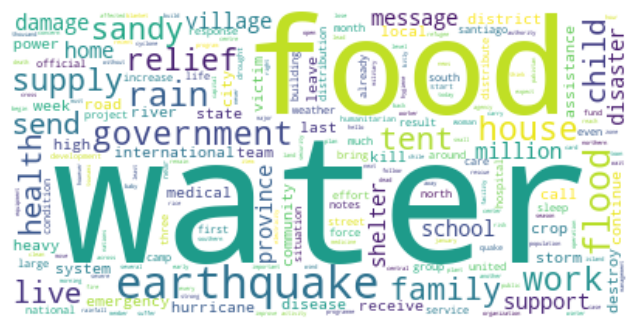

None

In [335]:
from IPython.display import display
# Train word_cloud
plt.imshow(wordcloud_train, interpolation='bilinear')
plt.axis("off")
display(plt.show())

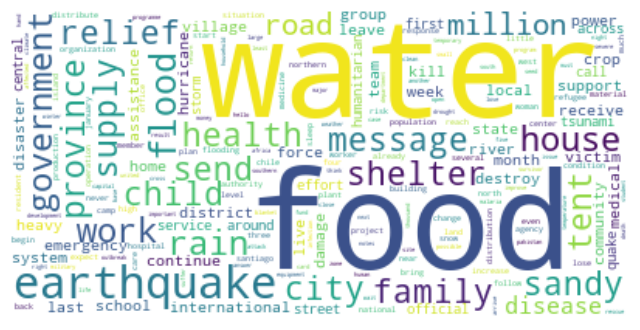

In [336]:
# Test word_cloud
plt.imshow(wordcloud_test, interpolation='bilinear')
plt.axis("off")
plt.show()

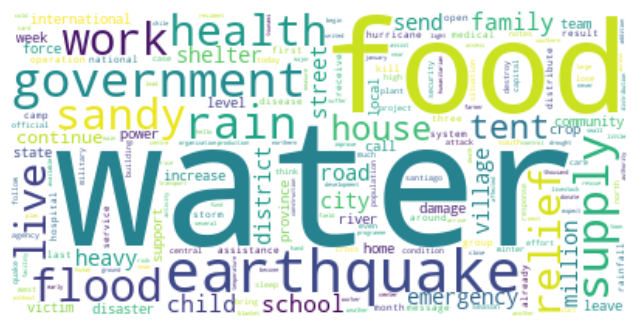

In [337]:
# Valid word_cloud
plt.imshow(wordcloud_valid, interpolation='bilinear')
plt.axis("off")
plt.show()

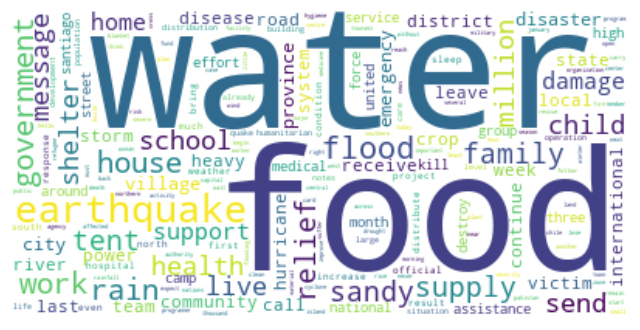

In [338]:
# Dfword_cloud
plt.imshow(wordcloud_df, interpolation='bilinear')
plt.axis("off")
plt.show()

2.3 TF-IDF

In [339]:
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd
from sklearn.decomposition import TruncatedSVD

# Create a TfidfVectorizer object and fit it on the "message" column of the dataframe
tfidf_df_test = TfidfVectorizer(max_features=30)
tfidf_df_test_matrix = tfidf_df_test.fit_transform(df_test['message_cleaned'])

# Create a DataFrame from the TF-IDF matrix
tfidf_df_test_matrix=pd.DataFrame(tfidf_df_test_matrix.toarray(), columns=tfidf_df_test.get_feature_names_out())
tfidf_df_test_matrix.fillna(value="", inplace=True)
# Instantiate a TruncatedSVD object and fit it to the tfidf matrix
# svd = TruncatedSVD(n_components=100)
# svd.fit(tfidf_df_test_matrix)

# Transform the tfidf matrix using the fitted TruncatedSVD object
# tfidf_df_test_svd = svd.transform(tfidf_df_test_matrix)
# tfidf_df_test_svd=pd.DataFrame(tfidf_df_test_svd)

In [340]:
# Create a TfidfVectorizer object and fit it on the "message" column of the dataframe
tfidf_df_train = TfidfVectorizer(max_features=30)
tfidf_df_train_matrix = tfidf_df_train.fit_transform(df_train['message_cleaned'])

# Create a DataFrame from the TF-IDF matrix
tfidf_df_train_matrix=pd.DataFrame(tfidf_df_train_matrix.toarray(), columns=tfidf_df_train.get_feature_names_out())
tfidf_df_train_matrix.fillna(value="", inplace=True)
# Instantiate a TruncatedSVD object and fit it to the tfidf matrix
# svd = TruncatedSVD(n_components=100)
# svd.fit(tfidf_df_train_matrix)

# Transform the tfidf matrix using the fitted TruncatedSVD object
# tfidf_df_train_svd = svd.transform(tfidf_df_train_matrix)
# tfidf_df_train_svd=pd.DataFrame(tfidf_df_train_svd)

In [341]:
# Create a TfidfVectorizer object and fit it on the "message" column of the dataframe
tfidf_df_valid = TfidfVectorizer(max_features=30)
tfidf_df_valid_matrix = tfidf_df_valid.fit_transform(df_valid['message_cleaned'])

# Create a DataFrame from the TF-IDF matrix
tfidf_df_valid_matrix=pd.DataFrame(tfidf_df_valid_matrix.toarray(), columns=tfidf_df_valid.get_feature_names_out())
tfidf_df_valid_matrix.fillna(value="", inplace=True)
# Instantiate a TruncatedSVD object and fit it to the tfidf matrix
# svd = TruncatedSVD(n_components=100)
# svd.fit(tfidf_df_valid_matrix)

# Transform the tfidf matrix using the fitted TruncatedSVD object
# tfidf_df_valid_svd = svd.transform(tfidf_df_valid_matrix)
# tfidf_df_valid_svd=pd.DataFrame(tfidf_df_valid_svd)

In [342]:
# Create a TfidfVectorizer object and fit it on the "message" column of the dataframe
tfidf_df = TfidfVectorizer(max_features=30)
tfidf_df_matrix = tfidf_df.fit_transform(df['message_cleaned'])

# Create a DataFrame from the TF-IDF matrix
tfidf_df_matrix=pd.DataFrame(tfidf_df_matrix.toarray(), columns=tfidf_df.get_feature_names_out())
tfidf_df_matrix.fillna(value="", inplace=True)
# Instantiate a TruncatedSVD object and fit it to the tfidf matrix
# svd = TruncatedSVD(n_components=100)
# svd.fit(tfidf_df_matrix)

# Transform the tfidf matrix using the fitted TruncatedSVD object
# tfidf_df_svd = svd.transform(tfidf_df_matrix)
# tfidf_df_svd=pd.DataFrame(tfidf_df_svd)

In [343]:
tfidf_df_test_matrix

,child,city,disease,district,earthquake,emergency,family,flood,food,government,...,road,sandy,school,send,shelter,supply,support,tent,water,work
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.000000,0.00000,0.00000,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,1.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2624,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.708192,0.00000,0.70602,0.0,0.0
2625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0
2626,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.00000,0.00000,0.0,0.0
2627,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.664812,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.74701,0.00000,0.0,0.0


In [344]:
tfidf_df_train_matrix

,child,damage,disaster,earthquake,emergency,family,flood,food,government,health,...,school,send,shelter,storm,supply,support,tent,village,water,work
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21041,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21042,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
21043,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21044,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [345]:
tfidf_df_valid_matrix

,child,city,community,continue,crop,district,earthquake,emergency,family,flood,...,sandy,school,send,shelter,street,supply,tent,village,water,work
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.711567,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.711567,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2568,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2569,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2570,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [346]:
tfidf_df_matrix

,child,city,community,damage,disaster,earthquake,emergency,family,flood,food,...,sandy,school,send,shelter,supply,support,tent,village,water,work
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26243,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26244,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26245,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26246,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [347]:
tfidf_df_train_matrix.fillna(value=0, inplace=True)
tfidf_df_test_matrix.fillna(value=0, inplace=True)
tfidf_df_valid_matrix.fillna(value=0, inplace=True)
tfidf_df_matrix.fillna(value=0, inplace=True)


In [348]:
feature_df_names=list(tfidf_df.get_feature_names_out())
feature_train_names=list(tfidf_df_train.get_feature_names_out())
feature_test_names=list(tfidf_df_test.get_feature_names_out())
feature_valid_names=list(tfidf_df_valid.get_feature_names_out())

**2.4 Kmeans:**

2.4.1 Elbow method

In [349]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

In [350]:
def elbow_draw(df, lower_range=1, higher_range=50, max_iter=100, n_init=1, random_state=42):
    import matplotlib.pyplot as plt
    from sklearn.cluster import KMeans

    # Create a list to store the SSE values for each k
    sse = []

    # Fit the KMeans model for each k and calculate the SSE
    for k in range(lower_range, higher_range):
        km = KMeans(n_clusters=k, init='k-means++', max_iter=max_iter, n_init=n_init, random_state=random_state)
        km.fit(df)
        sse.append(km.inertia_)

    # Find the elbow point (the point of maximum curvature)
    diffs = [sse[i] - sse[i-1] for i in range(1, len(sse))]
    elbow_point = diffs.index(max(diffs)) + 1

    # Plot the SSE values for each k
    plt.plot(range(lower_range, higher_range), sse)
    plt.title('Elbow Method')
    plt.xlabel('Number of Clusters')
    plt.ylabel('SSE')

    # Plot the elbow point on the graph
    plt.scatter(elbow_point, sse[elbow_point-1], marker='o', color='red')

    # Print the elbow point value
    print("The optimal number of clusters is:", elbow_point)

    plt.show()

In [351]:
import itertools

def elbow_list(df, lower_range=1, higher_range=50, max_iter=100, n_init=1, random_state=42):
    import pandas as pd
    from sklearn.cluster import KMeans
    import numpy as np

    # Create a list to store the SSE values for each k
    sse = []

    # Fit the KMeans model for each k and calculate the SSE
    for k in range(lower_range, higher_range):
        km = KMeans(n_clusters=k, init='k-means++', max_iter=max_iter, n_init=n_init, random_state=random_state)
        km.fit(df)
        sse.append(km.inertia_)

    print("SSE values:", sse)

    # Create the elbow matrix as a Pandas DataFrame
    elbow_matrix = []
    for i in range(1, len(sse) - 1):
        row = [0] * (i+1) + list(sse[i] - np.array(sse[i+1:]))
        elbow_matrix.append(row)

    print("Elbow matrix:", elbow_matrix)

    # Flatten the elbow matrix and display as a list
    flat_elbow_matrix = list(itertools.chain.from_iterable(elbow_matrix))
    print("Flattened Elbow Matrix:", flat_elbow_matrix)
    
    return flat_elbow_matrix


The optimal number of clusters is: 36


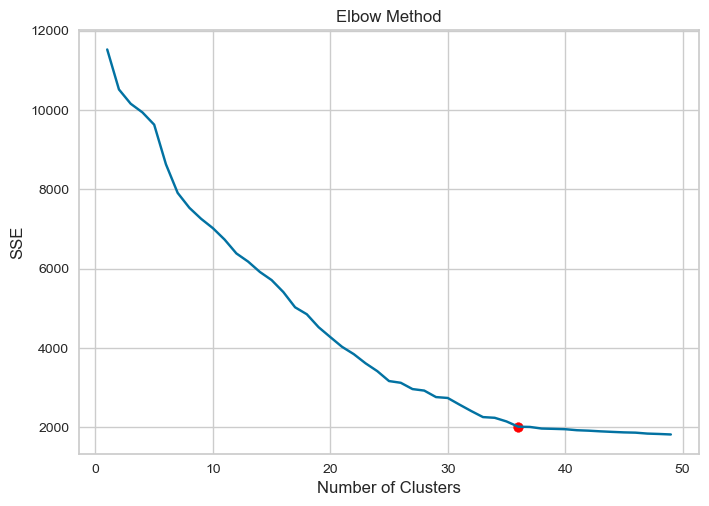

In [352]:
elbow_draw(tfidf_df_train_matrix, lower_range=1, higher_range=50, max_iter=100, n_init=1, random_state=42)

The optimal number of clusters is: 28


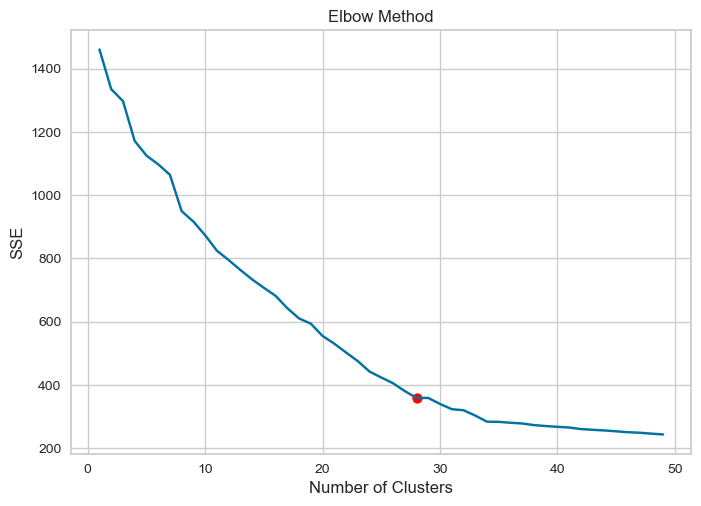

In [353]:
elbow_draw(tfidf_df_test_matrix, lower_range=1, higher_range=50, max_iter=100, n_init=1, random_state=42);

The optimal number of clusters is: 46


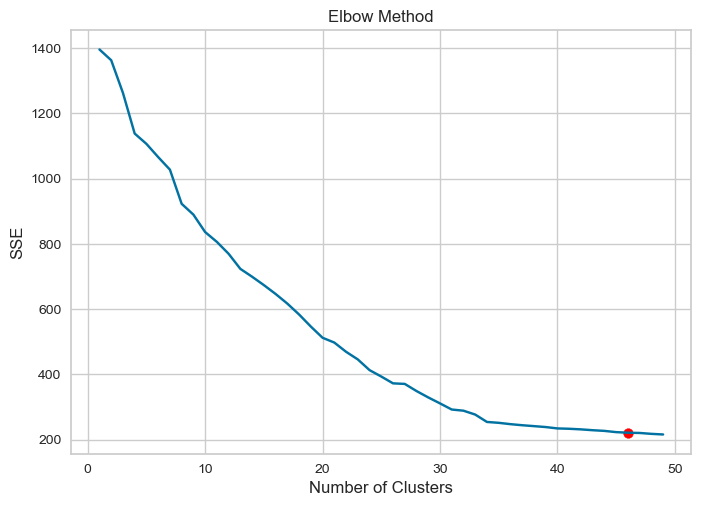

In [354]:
elbow_draw(tfidf_df_valid_matrix, lower_range=1, higher_range=50, max_iter=100, n_init=1, random_state=42);

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


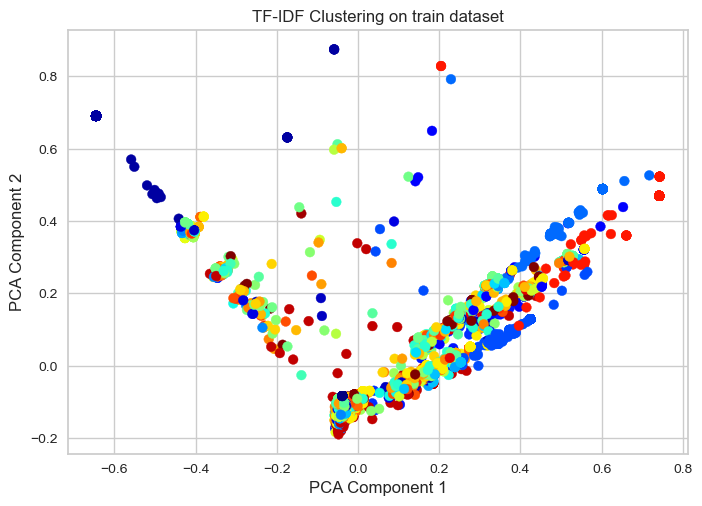

In [355]:
# Cluster the documents using k-means
k = 36
km_train = KMeans(n_clusters=k)
km_train.fit(tfidf_df_train_matrix)

# Reduce the dimensionality of the TF-IDF matrix for visualization
pca = PCA(n_components=2)
tfidf_train_reduced = pca.fit_transform(tfidf_df_train_matrix)

# Define a colormap
cmap = plt.cm.get_cmap('jet', k)

# Visualize the clusters
plt.scatter(tfidf_train_reduced[:, 0], tfidf_train_reduced[:, 1], c=km_train.labels_, cmap=cmap)

plt.title("TF-IDF Clustering on train dataset")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()


The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


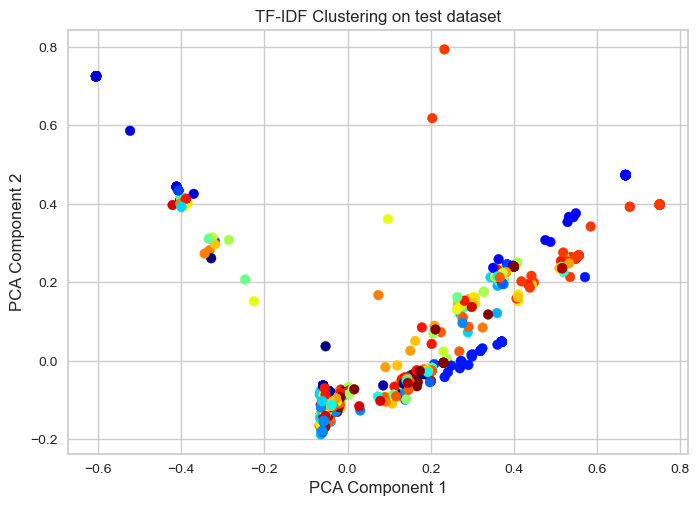

In [356]:
# Cluster the documents using k-means
k = 28
km_test = KMeans(n_clusters=k)
km_test.fit(tfidf_df_test_matrix)

# Reduce the dimensionality of the TF-IDF matrix for visualization
pca = PCA(n_components=2)
tfidf_test_reduced = pca.fit_transform(tfidf_df_test_matrix)

# Define a colormap
cmap = plt.cm.get_cmap('jet', k)

# Visualize the clusters
plt.scatter(tfidf_test_reduced[:, 0], tfidf_test_reduced[:, 1], c=km_test.labels_, cmap=cmap)

plt.title("TF-IDF Clustering on test dataset")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()


The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


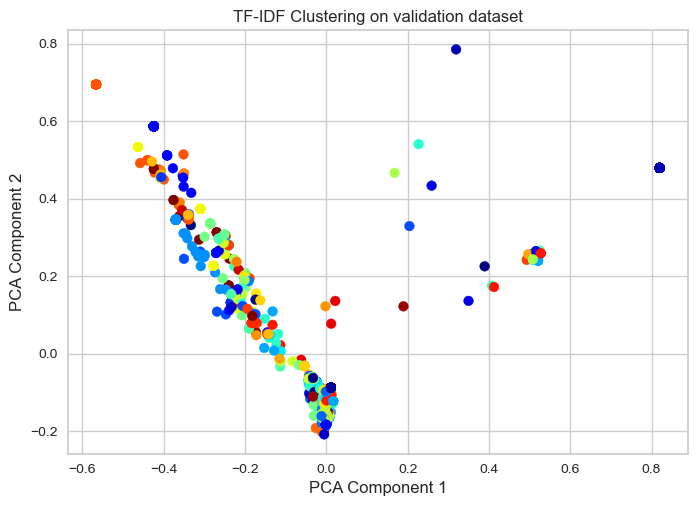

In [357]:
# Cluster the documents using k-means
k = 46
km_valid = KMeans(n_clusters=k)
km_valid.fit(tfidf_df_valid_matrix)

# Reduce the dimensionality of the TF-IDF matrix for visualization
pca = PCA(n_components=2)
tfidf_valid_reduced = pca.fit_transform(tfidf_df_valid_matrix)

# Define a colormap
cmap = plt.cm.get_cmap('jet', k)

# Visualize the clusters
plt.scatter(tfidf_valid_reduced[:, 0], tfidf_valid_reduced[:, 1], c=km_valid.labels_, cmap=cmap)

plt.title("TF-IDF Clustering on validation dataset")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.show()


2.4.2 Silhouette

The optimal number of clusters for train_df is: 38


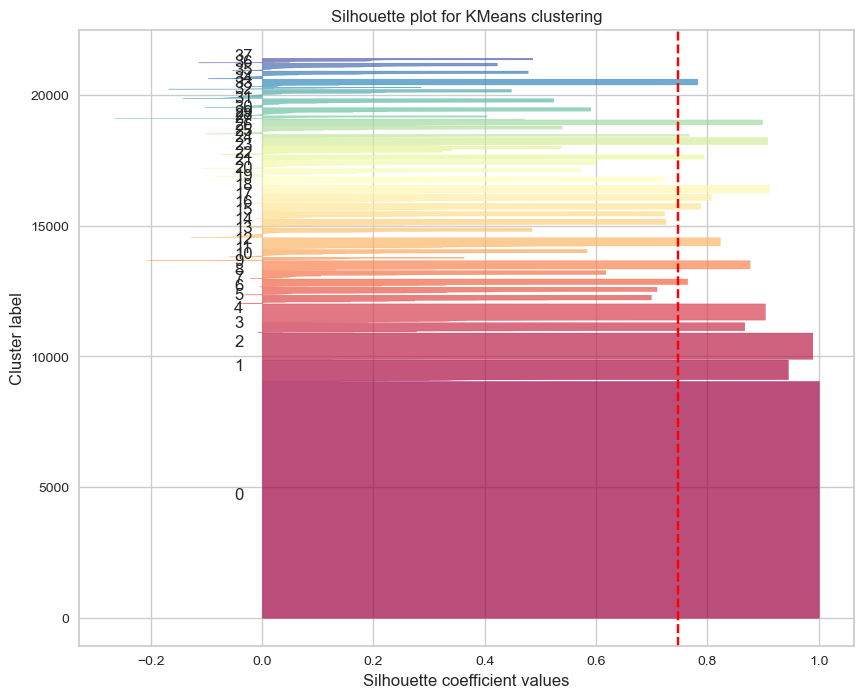

In [358]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

# Initialize a range of possible numbers of clusters
num_clusters = range(30, 40)

# Initialize a list to store the average silhouette scores for each number of clusters
silhouette_scores = []

# Fit a KMeans clustering algorithm for each number of clusters and calculate the silhouette score
for k in num_clusters:
    km = KMeans(n_clusters=k, init='k-means++', max_iter=100, n_init=1, random_state=42)
    labels = km.fit_predict(tfidf_df_train_matrix)
    silhouette_avg = silhouette_score(tfidf_df_train_matrix, labels)
    silhouette_scores.append(silhouette_avg)

# Find the number of clusters that gives the highest silhouette score
best_num_clusters = num_clusters[np.argmax(silhouette_scores)]
print("The optimal number of clusters for train_df is:", best_num_clusters)

# Fit a KMeans clustering algorithm with the best number of clusters
best_km = KMeans(n_clusters=best_num_clusters, init='k-means++', max_iter=100, n_init=1, random_state=42)
best_labels = best_km.fit_predict(tfidf_df_train_matrix)

# Calculate the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(tfidf_df_train_matrix, best_labels)

# Plot the silhouette scores for each sample
plt.figure(figsize=(10,8))
plt.title("Silhouette plot for KMeans clustering")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")

y_lower = 10
for i in range(best_num_clusters):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[best_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.Spectral(float(i) / best_num_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

# The vertical line for average silhoutte score of all the values
plt.axvline(x=silhouette_avg, color="red", linestyle="--")

plt.show()


The optimal number of clusters for test_df is: 39


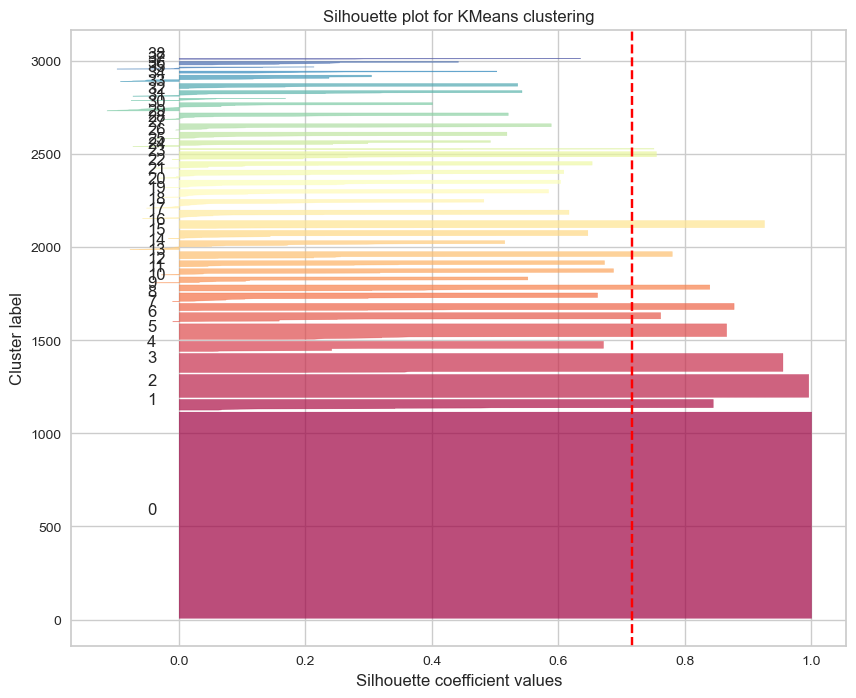

In [359]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

# Initialize a range of possible numbers of clusters
num_clusters = range(30, 40)

# Initialize a list to store the average silhouette scores for each number of clusters
silhouette_scores = []

# Fit a KMeans clustering algorithm for each number of clusters and calculate the silhouette score
for k in num_clusters:
    km = KMeans(n_clusters=k, init='k-means++', max_iter=100, n_init=1, random_state=42)
    labels = km.fit_predict(tfidf_df_test_matrix)
    silhouette_avg = silhouette_score(tfidf_df_test_matrix, labels)
    silhouette_scores.append(silhouette_avg)

# Find the number of clusters that gives the highest silhouette score
best_num_clusters = num_clusters[np.argmax(silhouette_scores)]
print("The optimal number of clusters for test_df is:", best_num_clusters)

# Fit a KMeans clustering algorithm with the best number of clusters
best_km = KMeans(n_clusters=best_num_clusters, init='k-means++', max_iter=100, n_init=1, random_state=42)
best_labels = best_km.fit_predict(tfidf_df_test_matrix)

# Calculate the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(tfidf_df_test_matrix, best_labels)

# Plot the silhouette scores for each sample
plt.figure(figsize=(10,8))
plt.title("Silhouette plot for KMeans clustering")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")

y_lower = 10
for i in range(best_num_clusters):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[best_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.Spectral(float(i) / best_num_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

# The vertical line for average silhoutte score of all the values
plt.axvline(x=silhouette_avg, color="red", linestyle="--")

plt.show()


The optimal number of clusters for valid_df is: 39


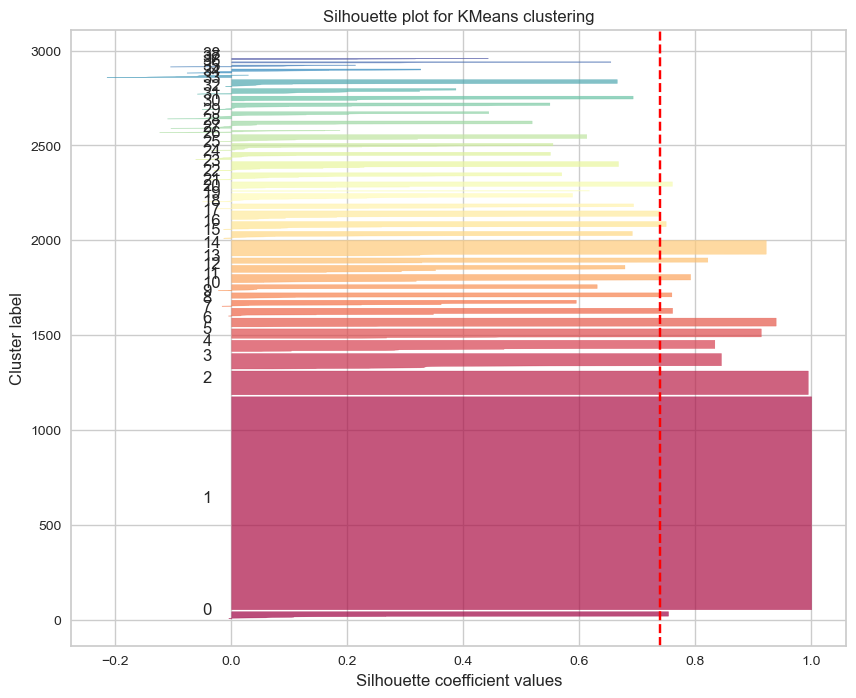

In [360]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

# Initialize a range of possible numbers of clusters
num_clusters = range(30, 40)

# Initialize a list to store the average silhouette scores for each number of clusters
silhouette_scores = []

# Fit a KMeans clustering algorithm for each number of clusters and calculate the silhouette score
for k in num_clusters:
    km = KMeans(n_clusters=k, init='k-means++', max_iter=100, n_init=1, random_state=42)
    labels = km.fit_predict(tfidf_df_valid_matrix)
    silhouette_avg = silhouette_score(tfidf_df_valid_matrix, labels)
    silhouette_scores.append(silhouette_avg)

# Find the number of clusters that gives the highest silhouette score
best_num_clusters = num_clusters[np.argmax(silhouette_scores)]
print("The optimal number of clusters for valid_df is:", best_num_clusters)

# Fit a KMeans clustering algorithm with the best number of clusters
best_km = KMeans(n_clusters=best_num_clusters, init='k-means++', max_iter=100, n_init=1, random_state=42)
best_labels = best_km.fit_predict(tfidf_df_valid_matrix)

# Calculate the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(tfidf_df_valid_matrix, best_labels)

# Plot the silhouette scores for each sample
plt.figure(figsize=(10,8))
plt.title("Silhouette plot for KMeans clustering")
plt.xlabel("Silhouette coefficient values")
plt.ylabel("Cluster label")

y_lower = 10
for i in range(best_num_clusters):
    # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[best_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.Spectral(float(i) / best_num_clusters)
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

# The vertical line for average silhoutte score of all the values
plt.axvline(x=silhouette_avg, color="red", linestyle="--")

plt.show()


2.4.3. Plotting cluster

2.4.3.1 Training dataframe

2.4.3.1.1 Elbow

In [361]:
k=36
# Fit the KMeans clustering algorithm to the TF-IDF matrix
km_train.fit(tfidf_df_train_matrix)

# Retrieve the labels assigned to each document
labels_train = km_train.labels_

# Create a dictionary to store the text data for each cluster
cluster_train_data = {i: [] for i in range(k)}

# Filter the text data based on the cluster labels
for i, label in enumerate(labels_train):
    cluster_train_data[label].append(df_train['message_cleaned'][i])

# Compute the TF-IDF scores for each cluster
tfidf_train = TfidfVectorizer()
cluster_train_words = {}
min_cluster_size = 10 # Set the minimum number of documents for a cluster
for i in range(k):
    # Combine the documents in the cluster into a single string of text
    cluster_text_train = ' '.join(cluster_train_data[i])

    # Compute the TF-IDF scores for the words in the cluster text
    tfidf_train_matrix = tfidf_train.fit_transform([cluster_text_train])
    feature_train_names = tfidf_train.get_feature_names_out()
    tfidf_train_scores = tfidf_train_matrix.toarray()[0]

    # Retrieve the top N words with the highest TF-IDF scores and display them
    top_n = 10
    top_train_indices = tfidf_train_scores.argsort()[-top_n:][::-1]
    top_train_words = [feature_train_names[i] for i in top_train_indices]
    print(f"Cluster {i} top words: {', '.join(top_train_words)}")

# Create a Pandas DataFrame with the cluster results
df_train_cluster = pd.DataFrame({'Document': df_train['message_cleaned'], 'Cluster': labels_train})
df_train_cluster['Cluster'] = df_train_cluster['Cluster'].apply(lambda x: f"Cluster {x}")
df_train_cluster = pd.DataFrame(df_train_cluster)

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Cluster 0 top words: santiago, call, receive, city, state, disease, international, national, united, crop
Cluster 1 top words: damage, house, road, flood, power, water, destroy, rain, infrastructure, heavy
Cluster 2 top words: earthquake, bitly, news, magnitude, victim, tsunami, major, strike, twitter, another
Cluster 3 top words: water, drinking, system, river, sanitation, clean, tank, drink, source, disease
Cluster 4 top words: food, distribution, security, card, distribute, cook, clothing, bring, clothes, population
Cluster 5 top words: rain, heavy, flood, water, monsoon, season, crop, torrential, weather, expect
Cluster 6 top words: send, food, call, answer, phone, card, earthquake, never, government, water
Cluster 7 top words: work, food, water, government, community, local, international, organization, life, team
Cluster 8 top words: sandy, hurricane, power, frankenstorm, food, hurricanesandy, storm, city, back, others
Cluster 9 top words: school, open, child, student, teacher, p

In [362]:
df_train_cluster

,Document,Cluster
0,weather update cold front cuba pass,Cluster 0
1,hurricane,Cluster 0
2,west side rest today tonight,Cluster 0
3,national palace,Cluster 0
4,storm sacred heart jesus,Cluster 20
...,...,...
21041,training demonstrate enhance micronutrient pro...,Cluster 0
21042,suitable candidate select ocha jakarta current...,Cluster 7
21043,proshika operate coxs bazar municipality union...,Cluster 18
21044,woman protest conduct election teargas converg...,Cluster 0


In [363]:
dict_train_cluster= {}
for cluster in df_train_cluster['Cluster'].unique():
    docs = df_train_cluster.loc[df_train_cluster['Cluster'] == cluster, 'Document']
    dict_train_cluster[cluster] = docs.tolist()

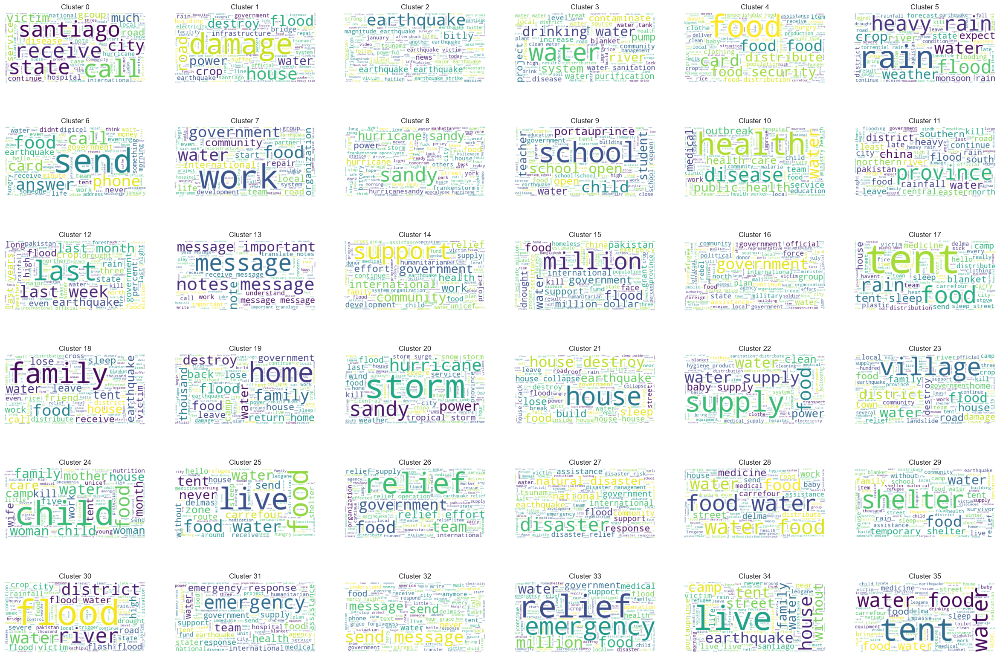

In [364]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# create the figure and subplots
fig, axs = plt.subplots(6, 6, figsize=(30, 20))

# plot word clouds for all subplots
for i, ax in enumerate(axs.flatten()):
    if i < 36:
        text = ' '.join(dict_train_cluster[f'Cluster {i}'])
        wordcloud = WordCloud(background_color="white").generate(text)
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.axis("off")
        ax.set_title(f'Cluster {i}')
    else:
        ax.axis("off")

# adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# display the plot
plt.show()


2.4.3.1.2 Silhouette

Blank dataframe

2.4.3.2 Testing dataframe

2.4.3.1.1 Elbow

In [365]:
k=28
# Fit the KMeans clustering algorithm to the TF-IDF matrix
km_test.fit(tfidf_df_test_matrix)

# Retrieve the labels assigned to each document
labels_test = km_test.labels_

# Create a dictionary to store the text data for each cluster
cluster_test_data = {i: [] for i in range(k)}

# Filter the text data based on the cluster labels
for i, label in enumerate(labels_test):
    cluster_test_data[label].append(df_test['message_cleaned'][i])

# Compute the TF-IDF scores for each cluster
tfidf_test = TfidfVectorizer()
cluster_test_words = {}
min_cluster_size = 10 # Set the minimum number of documents for a cluster
for i in range(k):
    # Combine the documents in the cluster into a single string of text
    cluster_text_test = ' '.join(cluster_test_data[i])

    # Compute the TF-IDF scores for the words in the cluster text
    tfidf_test_matrix = tfidf_test.fit_transform([cluster_text_test])
    feature_test_names = tfidf_test.get_feature_names_out()
    tfidf_test_scores = tfidf_test_matrix.toarray()[0]

    # Retrieve the top N words with the highest TF-IDF scores and display them
    top_n = 10
    top_test_indices = tfidf_test_scores.argsort()[-top_n:][::-1]
    top_test_words = [feature_test_names[i] for i in top_test_indices]
    print(f"Cluster {i} top words: {', '.join(top_test_words)}")

# Create a Pandas DataFrame with the cluster results
df_test_cluster = pd.DataFrame({'Document': df_test['message_cleaned'], 'Cluster': labels_test})
df_test_cluster['Cluster'] = df_test_cluster['Cluster'].apply(lambda x: f"Cluster {x}")
df_test_cluster = pd.DataFrame(df_test_cluster)

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Cluster 0 top words: international, community, humanitarian, force, medical, organization, bamboo, refugee, effort, government
Cluster 1 top words: santiago, chile, village, land, group, love, continue, system, back, last
Cluster 2 top words: food, clothing, supply, crop, production, distribute, product, hungry, card, nonperishable
Cluster 3 top words: earthquake, bitly, relief, chile, news, magnitude, donate, strike, quake, january
Cluster 4 top words: water, food, supply, drink, drinking, system, clean, river, level, sanitation
Cluster 5 top words: message, notes, send, important, pass, translate, receive, work, answer, food
Cluster 6 top words: rain, heavy, flood, crop, expect, southern, river, past, flooding, condition
Cluster 7 top words: sandy, hurricane, food, storm, power, home, back, hurricanesandy, frankenstorm, thing
Cluster 8 top words: million, flood, state, home, international, government, according, half, damage, nearly
Cluster 9 top words: school, water, child, destroy,

In [366]:
df_test_cluster

,Document,Cluster
0,leogane destroy hospital croix function needs ...,Cluster 1
1,gressier assistance right away asap,Cluster 1
2,delmas silo water,Cluster 4
3,police officer street insecure,Cluster 1
4,driver mechanic,Cluster 1
...,...,...
2624,unhcr supply basic nonfood item sanitary mosqu...,Cluster 10
2625,first organization respond midnovember outbrea...,Cluster 0
2626,president government always believe democratic...,Cluster 13
2627,following severe flood occur previous ircs bra...,Cluster 25


In [367]:
dict_test_cluster= {}
for cluster in df_test_cluster['Cluster'].unique():
    docs = df_test_cluster.loc[df_test_cluster['Cluster'] == cluster, 'Document']
    dict_test_cluster[cluster] = docs.tolist()

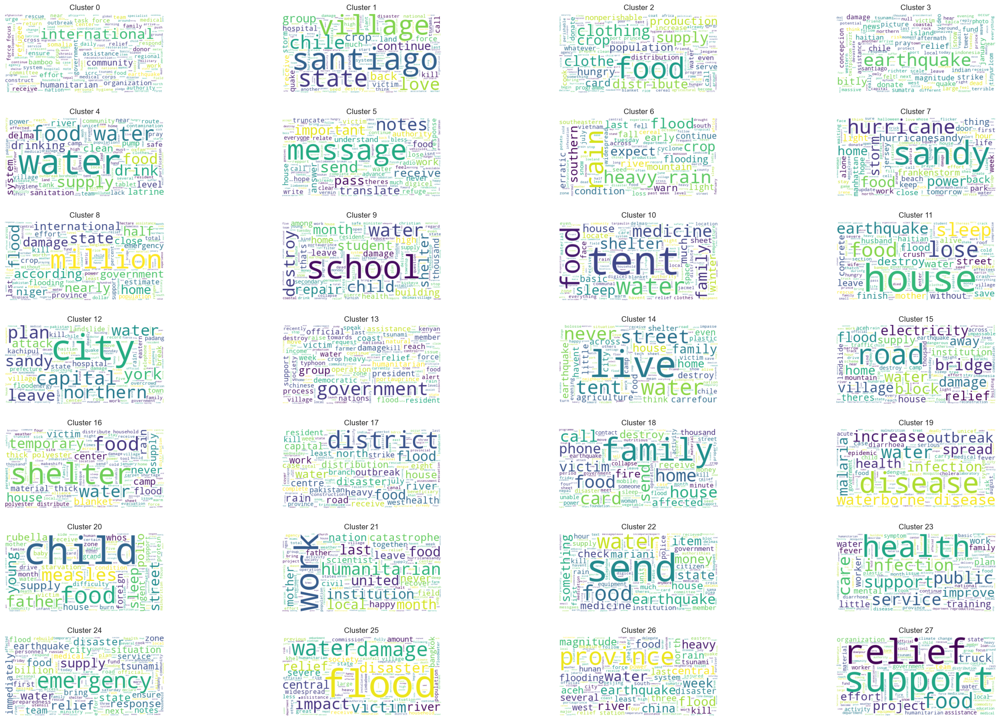

In [368]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# create the figure and subplots
fig, axs = plt.subplots(7, 4, figsize=(30, 20))

# plot word clouds for all subplots
for i, ax in enumerate(axs.flatten()):
    if i < 28:
        text = ' '.join(dict_test_cluster[f'Cluster {i}'])
        wordcloud = WordCloud(background_color="white").generate(text)
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.axis("off")
        ax.set_title(f'Cluster {i}')
    else:
        ax.axis("off")

# adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# display the plot
plt.show()

2.4.3.2.2 Silhouette

It still shows 28 clusters

2.4.3.3. Validation dataframe

2.4.3.3.1 Elbow

In [369]:
k=46
# Fit the KMeans clustering algorithm to the TF-IDF matrix
km_valid.fit(tfidf_df_valid_matrix)

# Retrieve the labels assigned to each document
labels_valid = km_valid.labels_

# Create a dictionary to store the text data for each cluster
cluster_valid_data = {i: [] for i in range(k)}

# Filter the text data based on the cluster labels
for i, label in enumerate(labels_valid):
    cluster_valid_data[label].append(df_valid['message_cleaned'][i])

# Compute the TF-IDF scores for each cluster
tfidf_valid = TfidfVectorizer()
cluster_valid_words = {}
min_cluster_size = 10 # Set the minimum number of documents for a cluster
for i in range(k):
    # Combine the documents in the cluster into a single string of text
    cluster_text_valid = ' '.join(cluster_valid_data[i])

    # Compute the TF-IDF scores for the words in the cluster text
    tfidf_valid_matrix = tfidf_valid.fit_transform([cluster_text_valid])
    feature_valid_names = tfidf_valid.get_feature_names_out()
    tfidf_valid_scores = tfidf_valid_matrix.toarray()[0]

    # Retrieve the top N words with the highest TF-IDF scores and display them
    top_n = 10
    top_valid_indices = tfidf_valid_scores.argsort()[-top_n:][::-1]
    top_valid_words = [feature_valid_names[i] for i in top_valid_indices]
    print(f"Cluster {i} top words: {', '.join(top_valid_words)}")

# Create a Pandas DataFrame with the cluster results
df_valid_cluster = pd.DataFrame({'Document': df_valid['message_cleaned'], 'Cluster': labels_valid})
df_valid_cluster['Cluster'] = df_valid_cluster['Cluster'].apply(lambda x: f"Cluster {x}")
df_valid_cluster = pd.DataFrame(df_valid_cluster)

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning


Cluster 0 top words: santiago, message, force, call, notes, hospital, national, today, much, storm
Cluster 1 top words: food, distribution, baby, clothes, card, distribute, rice, center, shortage, clothing
Cluster 2 top words: water, drinking, plant, operation, distribute, river, increase, resident, tank, purification
Cluster 3 top words: school, close, student, health, work, march, livestock, water, construction, live
Cluster 4 top words: rain, week, although, water, however, loss, shift, home, season, increase
Cluster 5 top words: earthquake, bitly, tsunami, news, victim, dead, powerful, thousands, impact, santiago
Cluster 6 top words: street, sleep, delmas, center, think, family, carrefour, outside, body, youaintboutdislifeforgot
Cluster 7 top words: city, large, concepcion, outside, countrys, increase, lava, week, chile, district
Cluster 8 top words: sandy, hurricane, power, storm, hurricanesandy, work, today, stock, snow, light
Cluster 9 top words: send, message, earthquake, food,

In [370]:
dict_valid_cluster= {}
for cluster in df_valid_cluster['Cluster'].unique():
    docs = df_valid_cluster.loc[df_valid_cluster['Cluster'] == cluster, 'Document']
    dict_valid_cluster[cluster] = docs.tolist()

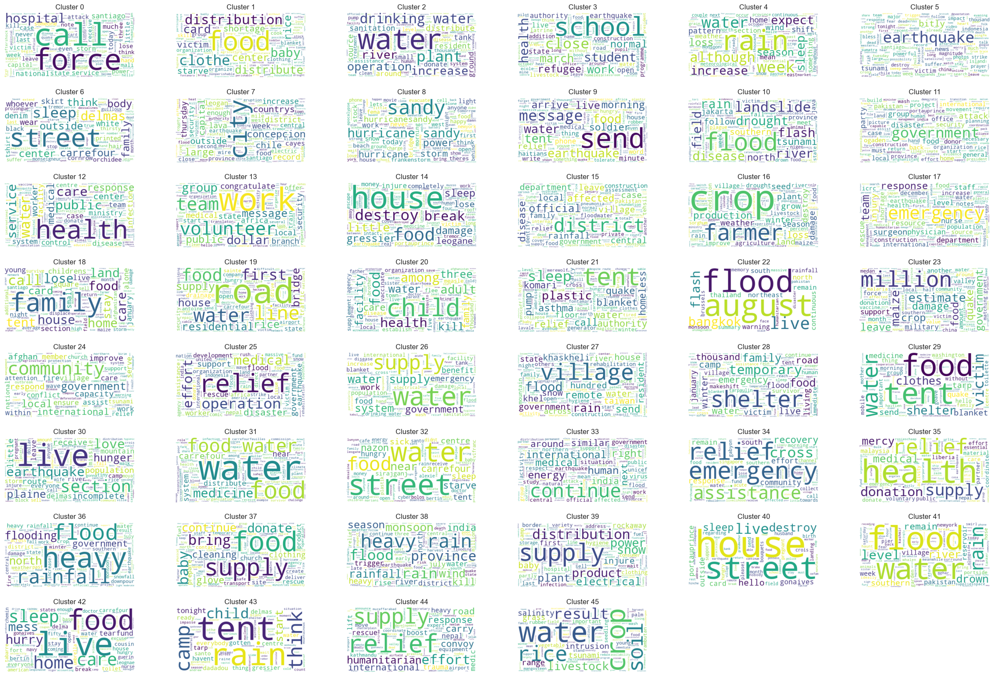

In [371]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# create the figure and subplots
fig, axs = plt.subplots(8, 6, figsize=(30, 20))

# plot word clouds for all subplots
for i, ax in enumerate(axs.flatten()):
    if i < 46:
        text = ' '.join(dict_valid_cluster[f'Cluster {i}'])
        wordcloud = WordCloud(background_color="white").generate(text)
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.axis("off")
        ax.set_title(f'Cluster {i}')
    else:
        ax.axis("off")

# adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# display the plot
plt.show()

2.4.3.3.2 Silhouette

Errors

2.4.4 Topic Modelling

In [372]:
import gensim
from gensim.corpora import Dictionary
import pyLDAvis
from pyLDAvis import gensim_models
from gensim.models.ldamodel import LdaModel

2.4.4.1 Cluster 1

2.4.4.1.1 Training

In [373]:
# Split each string in dict_train_cluster_0 into a list of tokens
corpus_train_cluster_1 = [doc.split() for doc in cluster_train_data[1]]

# Create a dictionary from the corpus
dictionary_train_cluster_1 = gensim.corpora.Dictionary(corpus_train_cluster_1)

# Convert the corpus to a bag-of-words format
corpus_bow_train_cluster_1 = [dictionary_train_cluster_1.doc2bow(doc) for doc in corpus_train_cluster_1]

# Train the LDA model
lda_model_train = LdaModel(corpus=corpus_bow_train_cluster_1, id2word=dictionary_train_cluster_1,
                            num_topics=4, random_state=100, update_every=1, chunksize=100, 
                            passes=10, alpha='auto', per_word_topics=True)

# Visualize the topics
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

pyLDAvis.enable_notebook()

vis_data = gensimvis.prepare(lda_model_train, corpus_bow_train_cluster_1, 
                             dictionary_train_cluster_1)
html = pyLDAvis.prepared_data_to_html(vis_data)
html = html.replace('width="100%"', 'width="400"').replace('height="100%"', 'height="300"')

from IPython.core.display import HTML
HTML(html)


In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.


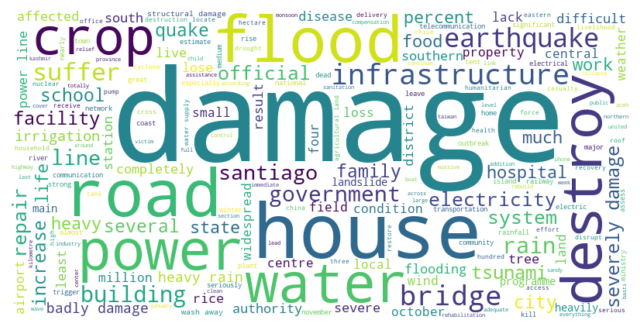

In [374]:
import warnings
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Ignore DeprecationWarnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Generate word cloud
text = ' '.join(dict_train_cluster['Cluster 1'])
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# # Save the word cloud as an image
# wordcloud.to_file("wordcloud.png")

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


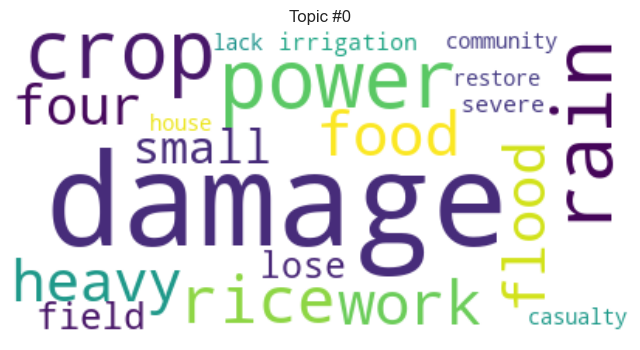

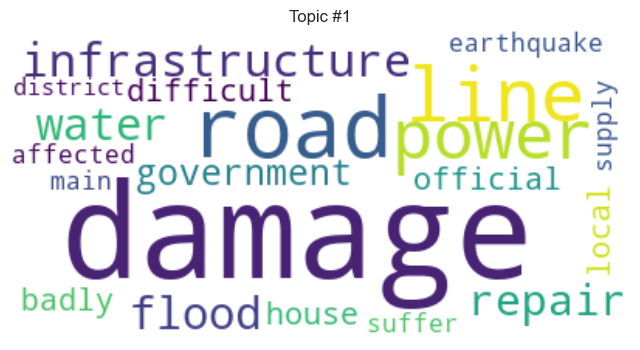

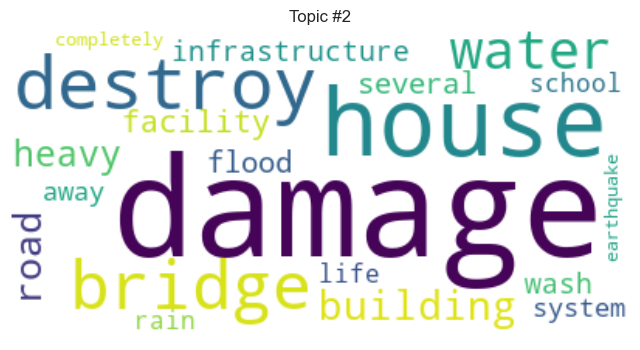

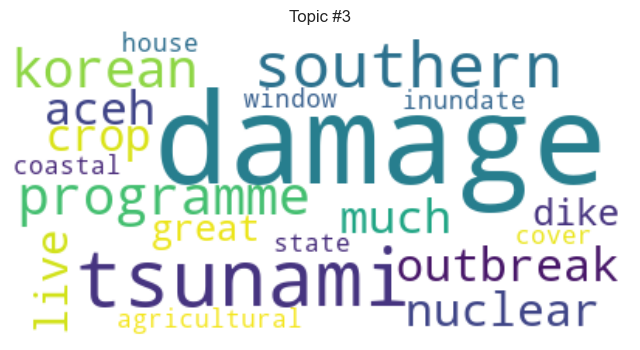

In [375]:
# Create word clouds for each topic
topics = lda_model_train.show_topics(num_topics=-1, num_words=20, formatted=False)
for topic in topics:
    topic_num = topic[0]
    topic_words = dict(topic[1])
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(topic_words)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title("Topic #{}".format(topic_num))
    plt.show()

2.4.4.1.2 Testing

In [376]:
# Split each string in dict_train_cluster_0 into a list of tokens
corpus_test_cluster_1 = [doc.split() for doc in cluster_test_data[1]]

# Create a dictionary from the corpus
dictionary_test_cluster_1 = gensim.corpora.Dictionary(corpus_test_cluster_1)

# Convert the corpus to a bag-of-words format
corpus_bow_test_cluster_1 = [dictionary_test_cluster_1.doc2bow(doc) for doc in corpus_test_cluster_1]

# Train the LDA model
lda_model_test = LdaModel(corpus=corpus_bow_test_cluster_1, id2word=dictionary_test_cluster_1,
                            num_topics=4, random_state=100, update_every=1, chunksize=100, 
                            passes=10, alpha='auto', per_word_topics=True)

# Visualize the topics
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

pyLDAvis.enable_notebook()

vis_data = gensimvis.prepare(lda_model_test, corpus_bow_test_cluster_1, 
                             dictionary_test_cluster_1)

html = pyLDAvis.prepared_data_to_html(vis_data)
html = html.replace('width="100%"', 'width="400"').replace('height="100%"', 'height="300"')

from IPython.core.display import HTML
HTML(html)


In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.


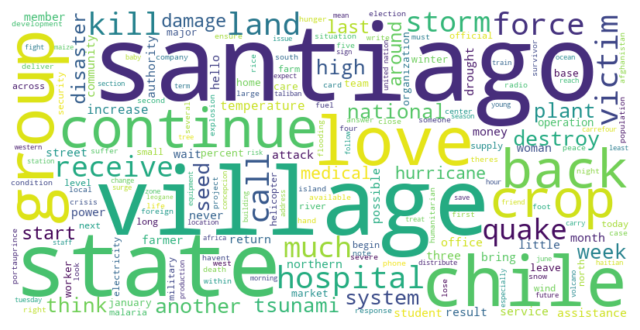

In [377]:
import warnings
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Ignore DeprecationWarnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Generate word cloud
text = ' '.join(dict_test_cluster['Cluster 1'])
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# # Save the word cloud as an image
# wordcloud.to_file("wordcloud.png")

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


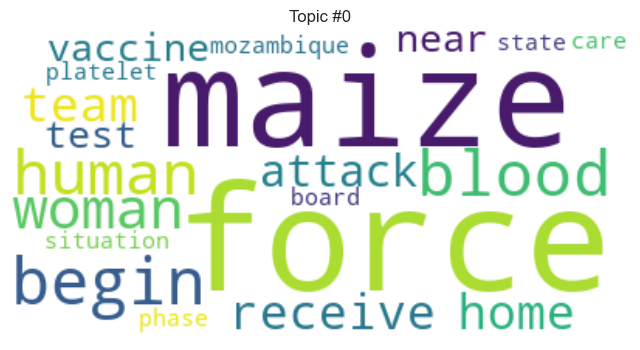

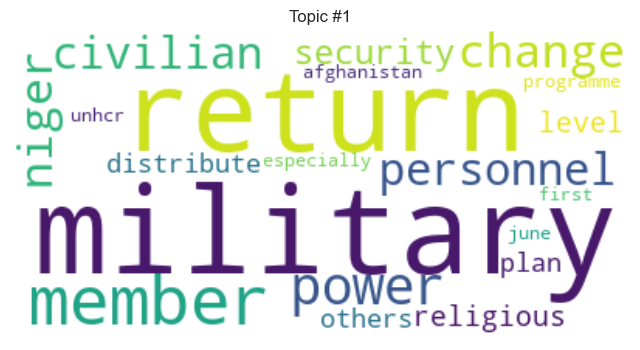

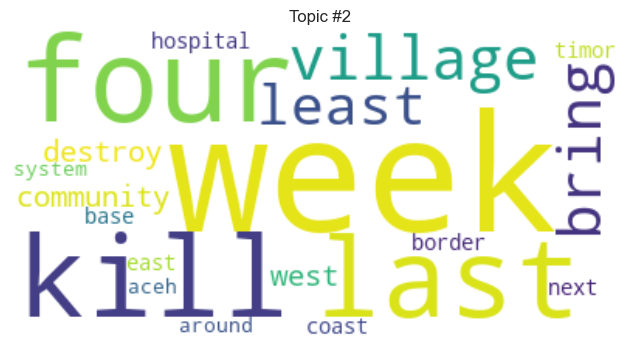

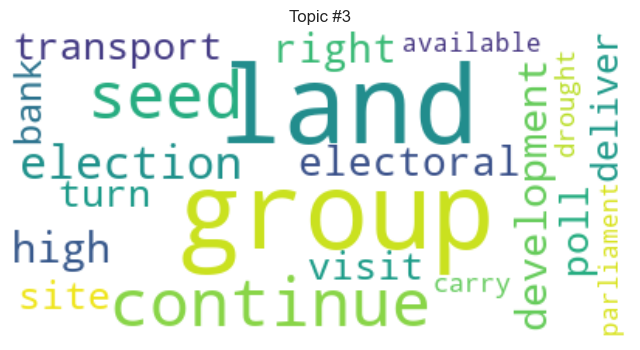

In [378]:
# Create word clouds for each topic
topics = lda_model_test.show_topics(num_topics=-1, num_words=20, formatted=False)
for topic in topics:
    topic_num = topic[0]
    topic_words = dict(topic[1])
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(topic_words)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title("Topic #{}".format(topic_num))
    plt.show()

2.4.4.1.3 Validation

In [379]:
# Split each string in dict_train_cluster_0 into a list of tokens
corpus_valid_cluster_1 = [doc.split() for doc in cluster_valid_data[1]]

# Create a dictionary from the corpus
dictionary_valid_cluster_1 = gensim.corpora.Dictionary(corpus_valid_cluster_1)

# Convert the corpus to a bag-of-words format
corpus_bow_valid_cluster_1 = [dictionary_valid_cluster_1.doc2bow(doc) for doc in corpus_valid_cluster_1]

# Train the LDA model
lda_model_valid = LdaModel(corpus=corpus_bow_valid_cluster_1, id2word=dictionary_valid_cluster_1,
                            num_topics=4, random_state=100, update_every=1, chunksize=100, 
                            passes=10, alpha='auto', per_word_topics=True)

# Visualize the topics
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

pyLDAvis.enable_notebook()

vis_data = gensimvis.prepare(lda_model_valid, corpus_bow_valid_cluster_1, 
                             dictionary_valid_cluster_1)
html = pyLDAvis.prepared_data_to_html(vis_data)
html = html.replace('width="100%"', 'width="400"').replace('height="100%"', 'height="300"')

from IPython.core.display import HTML
HTML(html)


In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.


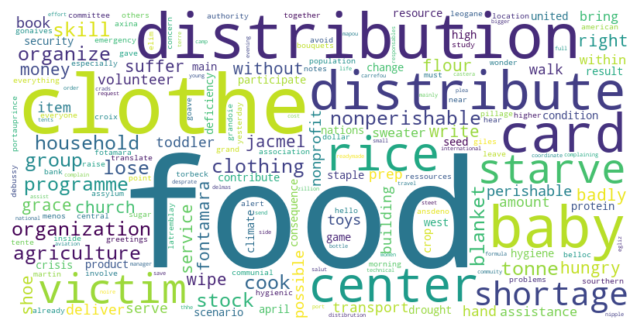

In [380]:
import warnings
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Ignore DeprecationWarnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Generate word cloud
text = ' '.join(dict_valid_cluster['Cluster 1'])
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# # Save the word cloud as an image
# wordcloud.to_file("wordcloud.png")

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()


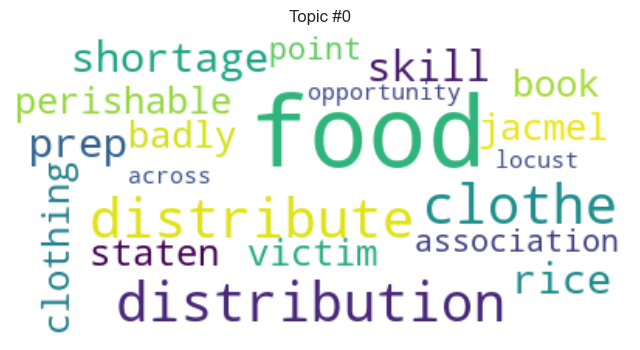

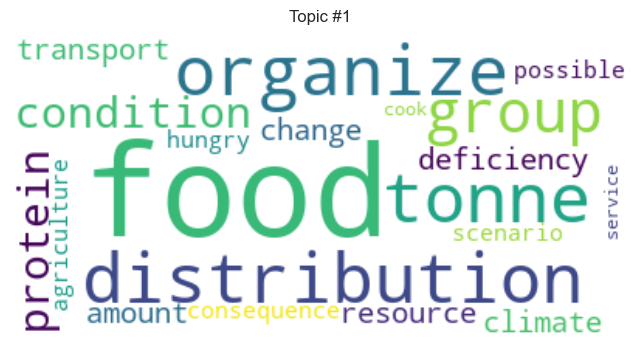

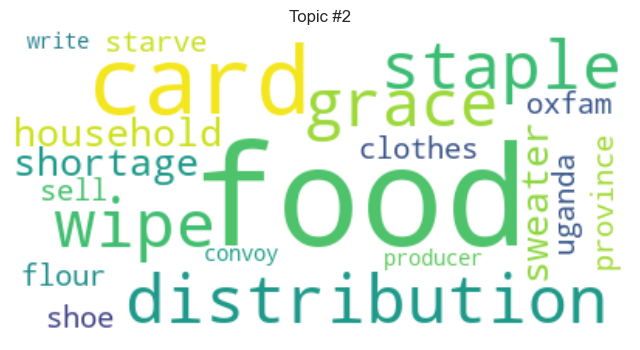

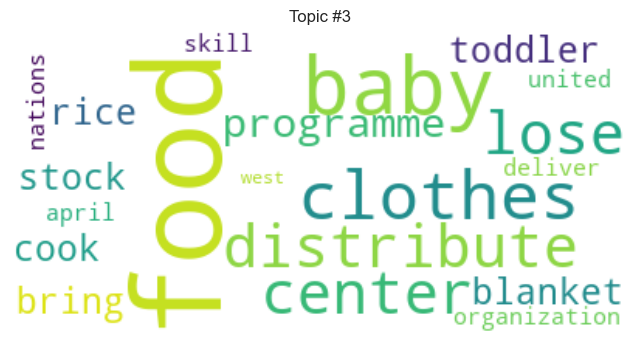

In [381]:
# Create word clouds for each topic
topics = lda_model_valid.show_topics(num_topics=-1, num_words=20, formatted=False)
for topic in topics:
    topic_num = topic[0]
    topic_words = dict(topic[1])
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(topic_words)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title("Topic #{}".format(topic_num))
    plt.show()

**III. TEXT CLASSIFICATION:**

In [382]:
df_train['message_cleaned']

0                      weather update cold front cuba pass
1                                                hurricane
2                             west side rest today tonight
3                                          national palace
4                                 storm sacred heart jesus
                               ...                        
21041    training demonstrate enhance micronutrient pro...
21042    suitable candidate select ocha jakarta current...
21043    proshika operate coxs bazar municipality union...
21044    woman protest conduct election teargas converg...
21045    radical shift thinking result meeting recogniz...
Name: message_cleaned, Length: 21046, dtype: object

In [383]:
import sklearn 
from sklearn.feature_extraction.text import TfidfVectorizer 
vectorizer = TfidfVectorizer()
# Create an empty array
X = np.array([], dtype=str) 
# Append text from all the splits to the empty array
X = np.append(X, df_train["message_cleaned"]) 
X = np.append(X, df_valid["message_cleaned"])
X = np.append(X, df_test["message_cleaned"])

In [384]:
vectorizer = TfidfVectorizer() # Load the tf-idf vectorizer from sklearn
vectorizer = vectorizer.fit(X) # Fit the vectorizer on the entire data

In [385]:
# Extract the vocabulary from the vectorizer
vocab = vectorizer.vocabulary_
print(f"Number of terms in the vocabulary = {len(vocab)}")

Number of terms in the vocabulary = 31769


In [386]:
# Display a sample of the word => value mapping
print("Sample Mapping")
for idx, ele in enumerate(zip(vocab.keys(), vocab.values())):
    word, val = ele
    print(f"{word} => {val}")
    if idx == 4: break

Sample Mapping
weather => 30738
update => 29824
cold => 5054
front => 10283
cuba => 6169


***IV. Label encoding and Predictive model: Food***

Does the message concern food? 1= yes, 0=no

In [387]:
df_train.head(2)

,id,split,message,genre,related,PII,request,offer,aid_related,medical_help,...,other_infrastructure,weather_related,floods,storm,fire,earthquake,cold,other_weather,direct_report,message_cleaned
0,2,train,Weather update - a cold front from Cuba that c...,direct,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,weather update cold front cuba pass
1,7,train,Is the Hurricane over or is it not over,direct,1,0,0,0,1,0,...,0,1,0,1,0,0,0,0,0,hurricane


In [388]:
y_train = df_train["food"].to_numpy()
y_val = df_valid["food"].to_numpy()
y_test = df_test["food"].to_numpy()

In [391]:
# Transform the text for each data split and store it in a variable
X_train = vectorizer.transform(df_train["message_cleaned"]).toarray()
X_val= vectorizer.transform(df_valid["message_cleaned"]).toarray()
X_test = vectorizer.transform(df_test["message_cleaned"]).toarray()

***1. Logistic Regression***

In [392]:
from sklearn.linear_model import LogisticRegression 
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix 
from sklearn.metrics import ConfusionMatrixDisplay 

import matplotlib.pyplot as plt

In [393]:
# Load the model
lr_model = LogisticRegression()

# Fit the model
lr_model.fit(X=X_train, y=y_train)

# Obtain the predictions for the validation data
pred_val = lr_model.predict(X_val)

# Get the classification report for the prediction
# It is a dictionary that contains various metrics and their values
# We choose accuracy and weighted average f1-score as our metrics of choice
results = classification_report(y_true=y_val, y_pred=pred_val, output_dict=True, zero_division=0) # Use zero_devision to control warnings

print(f"Accuracy = {results['accuracy']*100:>.2f} %")
print(f"Weighted Avg F1-score = {results['weighted avg']['f1-score']:>.4f}")

Accuracy = 93.08 %
Weighted Avg F1-score = 0.9220


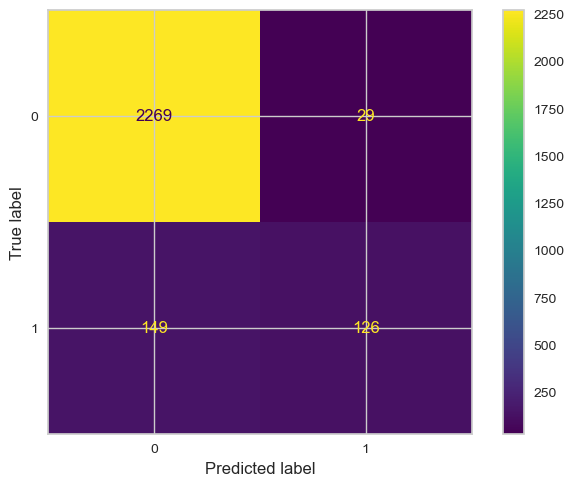

In [394]:
# Obtain the confusion matrix
cm = confusion_matrix(y_val, pred_val)

# Uncomment the following line to just print the matrix to the standard output
# print(cm)

cm_display = ConfusionMatrixDisplay(cm) # Initiate a ConfusionMatrixDisplay object
cm_display.plot() # Plot the object
plt.show() # Display the plot

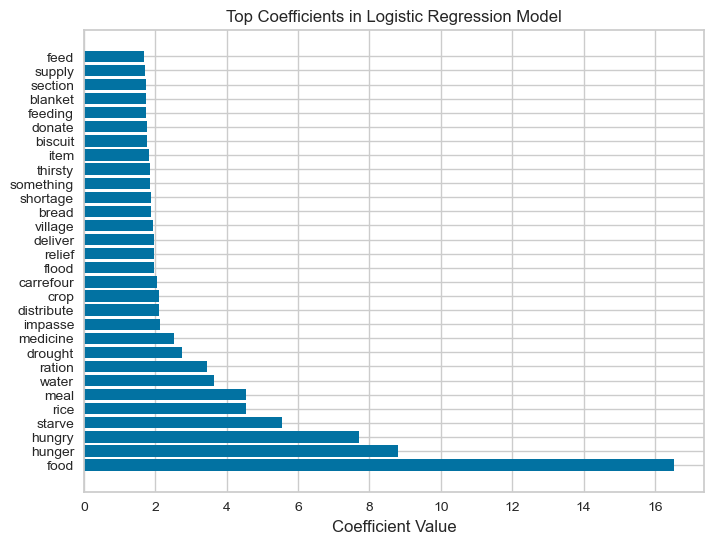

In [395]:
import matplotlib.pyplot as plt

# Obtain the feature names from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Obtain the coefficients of the logistic regression model
coefficients = lr_model.coef_[0]

# Sort the coefficients in descending order
sorted_coefficients = sorted(zip(coefficients, feature_names), reverse=True)

# Extract the top k coefficients and their corresponding feature names
k = 30
top_coefficients = sorted_coefficients[:k]
top_features = [feature for coef, feature in top_coefficients]

# Plot the top k coefficients and their corresponding feature names
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(top_features, [coef for coef, feature in top_coefficients])
ax.set_title("Top Coefficients in Logistic Regression Model")
ax.set_xlabel("Coefficient Value")
plt.show()

The above word cloud is generated based on the feature importance plot of a random forest classifier, which shows the importance of each feature (word) in predicting the target variable

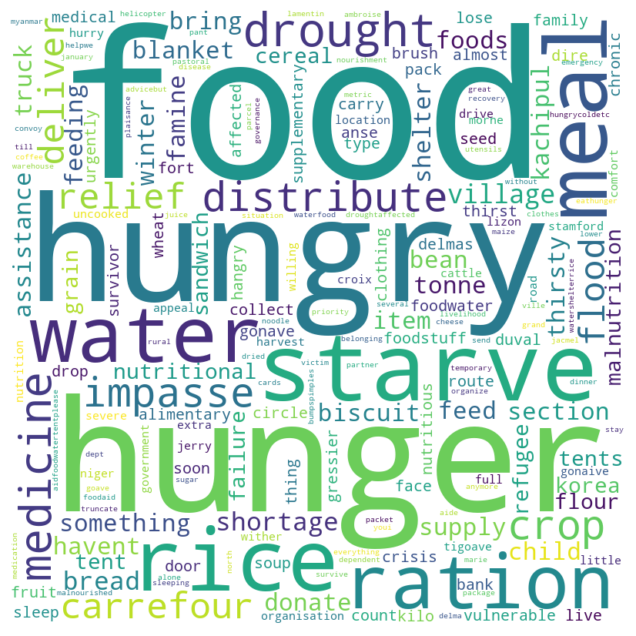

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Get the coefficients from the logistic regression model
coefficients = lr_model.coef_[0]

# Get the feature names (words) from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Combine the coefficients and feature names into a dictionary
word_scores = dict(zip(feature_names, coefficients))

# Generate the word cloud
wordcloud = WordCloud(width=800, height=800, background_color="white").generate_from_frequencies(word_scores)

# Display the word cloud
plt.figure(figsize=(8, 8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()


The coefficients represent the strength and direction of the relationship between each feature (word) and the predicted label (food or non-food).

It is suggested that the "not related to food" class is the most common class, leading to more instances that are correctly classified as not related to food and predicted as not related to food. As a result, the majority of the predicted labels are 0.

 The fact that the word cloud for the coefficients highlights words related to food suggests that there is a strong relationship between these words and the "related to food" class, despite the class imbalance (Class imbalance refers to the situation where the number of examples in one class is much larger than the other). 

***2. Decision Tree***

In [ ]:
# # Import the necessary libraries

# from sklearn.tree import DecisionTreeClassifier # Decision Tree Model for Classification

In [ ]:
# Define the vectorizer with your desired parameters
vectorizer = CountVectorizer()
# Fit the vectorizer to the training data
vectorizer.fit(df_train["message_cleaned"])
# Transform the text for each data split and store it in a variable
X_train = vectorizer.transform(df_train["message_cleaned"]).toarray()

In [ ]:
# # Load the model
# dt_model = DecisionTreeClassifier()

# # Fit the model
# dt_model.fit(X=X_train, y=y_train)

# # Obtain the predictions for the validation data
# pred_val = dt_model.predict(X_val)

# # Get the classification report for the prediction
# # It is a dictionary that contains various metrics and their values
# # We choose accuracy and weighted average f1-score as our metrics of choice
# results = classification_report(y_true=y_val, y_pred=pred_val, output_dict=True, zero_division=0) # Use zero_devision to control warnings

# print(f"Accuracy = {results['accuracy']*100:>.2f} %")
# print(f"Weighted Avg F1-score = {results['weighted avg']['f1-score']:>.4f}")

In [ ]:
# # Obtain the confusion matrix
# cm = confusion_matrix(y_val, pred_val)

# # Uncomment the following line to just print the matrix to the standard output
# # print(cm)

# cm_display = ConfusionMatrixDisplay(cm) # Initiate a ConfusionMatrixDisplay object
# cm_display.plot() # Plot the object
# plt.show() # Display the plot

In [ ]:
# # Extract the feature importance values
# importances = dt_model.feature_importances_


In [ ]:
# X_train

***3. SVM***

In [ ]:
from sklearn.svm import SVC

In [ ]:
# # Load the model
# svc_model = SVC()

# # Fit the model
# svc_model.fit(X=X_train, y=y_train)

# # Obtain the predictions for the validation data
# pred_val = svc_model.predict(X_val)

# # Get the classification report for the prediction
# # It is a dictionary that contains various metrics and their values
# # We choose accuracy and weighted average f1-score as our metrics of choice
# results = classification_report(y_true=y_val, y_pred=pred_val, output_dict=True, zero_division=0) # Use zero_devision to control warnings

# print(f"Accuracy = {results['accuracy']*100:>.2f} %")
# print(f"Weighted Avg F1-score = {results['weighted avg']['f1-score']:>.4f}")

In [ ]:
# # Obtain the confusion matrix
# cm = confusion_matrix(y_val, pred_val)

# # Uncomment the following line to just print the matrix to the standard output
# # print(cm)

# cm_display = ConfusionMatrixDisplay(cm) # Initiate a ConfusionMatrixDisplay object
# cm_display.plot() # Plot the object
# plt.show() # Display the plot

In [ ]:
# from wordcloud import WordCloud
# import matplotlib.pyplot as plt

# # Get the coefficients from the logistic regression model
# coefficients = svc_model.coef_[0]

# # Get the feature names (words) from the vectorizer
# feature_names = vectorizer.get_feature_names_out()

# # Combine the coefficients and feature names into a dictionary
# word_scores = dict(zip(feature_names, coefficients))

# # Generate the word cloud
# wordcloud = WordCloud(width=800, height=800, background_color="white").generate_from_frequencies(word_scores)

# # Display the word cloud
# plt.figure(figsize=(8, 8))
# plt.imshow(wordcloud, interpolation="bilinear")
# plt.axis("off")
# plt.show()


***V. Label encoding and Predictive model: Cold***

- cold: Does the message indicate there was a cold? 1= yes, 0=no

**1. Logistic regression**

In [ ]:
# Define the vectorizer with your desired parameters
vectorizer_val = CountVectorizer()
# Fit the vectorizer to the training data
vectorizer_val.fit(df_valid["message_cleaned"])
# Transform the text for each data split and store it in a variable
X_val = vectorizer.transform(df_valid["message_cleaned"]).toarray()

In [ ]:
y_train = df_train["cold"].to_numpy()
y_val = df_valid["cold"].to_numpy()
y_test = df_test["cold"].to_numpy()

In [ ]:
# Load the model
lr_model = LogisticRegression()

# Fit the model
lr_model.fit(X=X_train, y=y_train)

# Obtain the predictions for the validation data
pred_val = lr_model.predict(X_val)

# Get the classification report for the prediction
# It is a dictionary that contains various metrics and their values
# We choose accuracy and weighted average f1-score as our metrics of choice
results = classification_report(y_true=y_val, y_pred=pred_val, output_dict=True, zero_division=0) # Use zero_devision to control warnings

print(f"Accuracy = {results['accuracy']*100:>.2f} %")
print(f"Weighted Avg F1-score = {results['weighted avg']['f1-score']:>.4f}")

Accuracy = 98.06 %
Weighted Avg F1-score = 0.9779


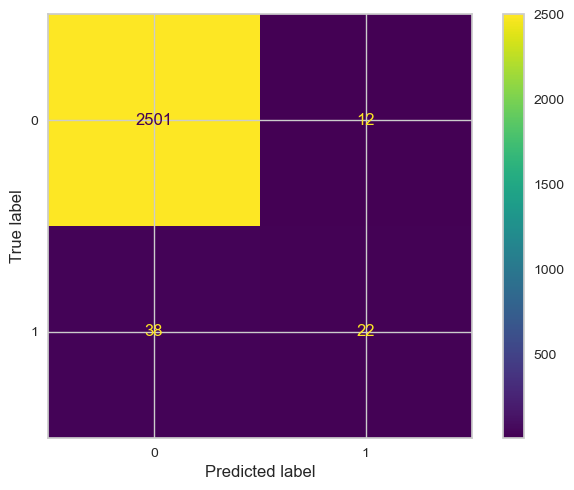

In [ ]:
# Obtain the confusion matrix
cm = confusion_matrix(y_val, pred_val)

# Uncomment the following line to just print the matrix to the standard output
# print(cm)

cm_display = ConfusionMatrixDisplay(cm) # Initiate a ConfusionMatrixDisplay object
cm_display.plot() # Plot the object
plt.show() # Display the plot

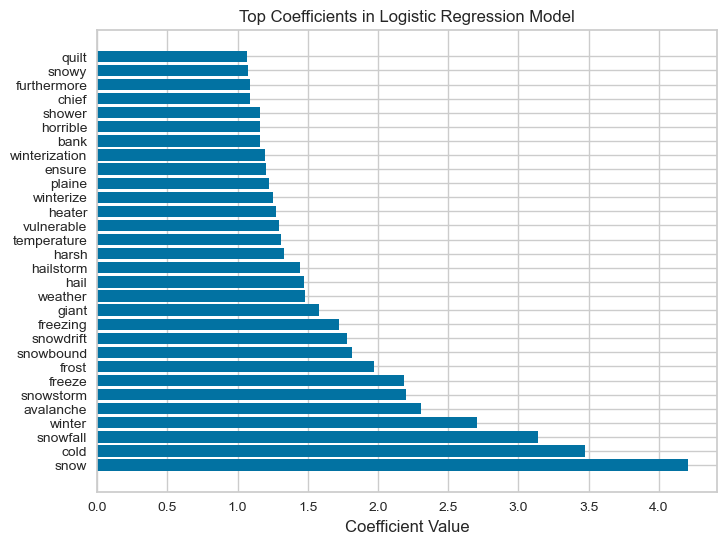

In [ ]:
import matplotlib.pyplot as plt

# Obtain the feature names from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Obtain the coefficients of the logistic regression model
coefficients = lr_model.coef_[0]

# Sort the coefficients in descending order
sorted_coefficients = sorted(zip(coefficients, feature_names), reverse=True)

# Extract the top k coefficients and their corresponding feature names
k = 30
top_coefficients = sorted_coefficients[:k]
top_features = [feature for coef, feature in top_coefficients]

# Plot the top k coefficients and their corresponding feature names
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(top_features, [coef for coef, feature in top_coefficients])
ax.set_title("Top Coefficients in Logistic Regression Model")
ax.set_xlabel("Coefficient Value")
plt.show()

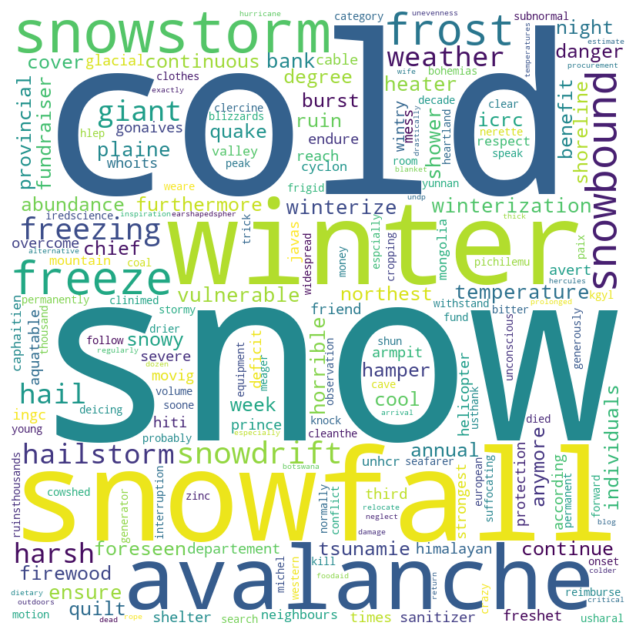

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Get the coefficients from the logistic regression model
coefficients = lr_model.coef_[0]

# Get the feature names (words) from the vectorizer
feature_names = vectorizer.get_feature_names_out()

# Combine the coefficients and feature names into a dictionary
word_scores = dict(zip(feature_names, coefficients))

# Generate the word cloud
wordcloud = WordCloud(width=800, height=800, background_color="white").generate_from_frequencies(word_scores)

# Display the word cloud
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()


The word cloud provides insight into the relationship between the independent variables and the dependent variable by identifying which variables have the strongest effects on the dependent variable.

In [ ]:
sample="There was a snow storm. It is freezing here"
sentences = vectorizer.transform([sample])
prediction = float(lr_model.predict(sentences))


In [ ]:
def cold_prediction(sample):
    sentences= vectorizer.transform([sample])
    prediction = float(lr_model.predict(sentences))
    # Print the prediction
    if prediction == 1:
        print("The message suggests that the place is cold.")
    else:
        print("The message suggests that the place is not cold.")

In [ ]:
sample="Winter is coming"
cold_prediction(sample)

The message suggests that the place is not cold.


***2. Random Forest***

In [ ]:
import shap
from sklearn.model_selection import train_test_split # package training and test data spilt
from sklearn.ensemble import RandomForestClassifier # package for random classifier
from sklearn.pipeline import make_pipeline # package for pipeline
from lime.lime_text import LimeTextExplainer # package for LIME explainer

In [ ]:
vectorizer = TfidfVectorizer(min_df=10) # assign the TF-ID model to find out the frequency of words
X_train_vec = vectorizer.fit_transform(df_train["message_cleaned"]).toarray() # create the TF-ID for the training data
X_test_vec = vectorizer.transform(df_test["message_cleaned"]).toarray() # create the TF-ID for the test data

In [ ]:
y_train = df_train["cold"].to_numpy()
y_val = df_valid["cold"].to_numpy()
y_test = df_test["cold"].to_numpy()

In [ ]:
model = RandomForestClassifier() # assign random classifier (black box) as a prediction model
model.fit(X_train_vec, y_train) # fit the training and test data into the prediction model

RandomForestClassifier()

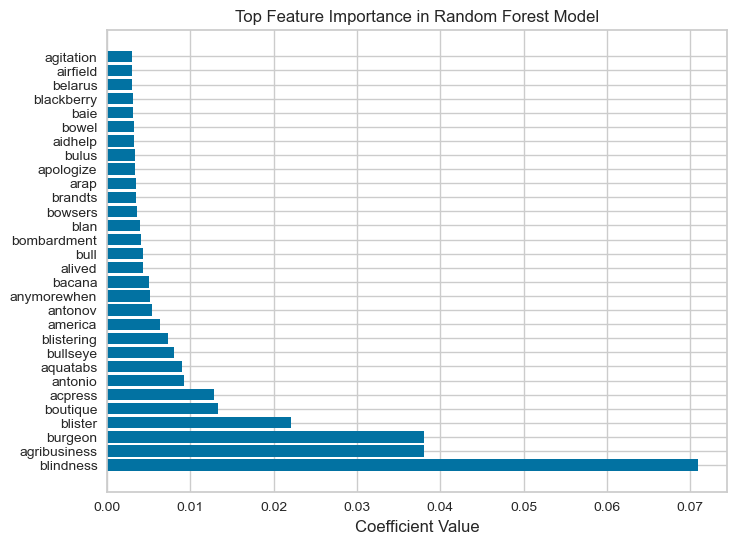

In [ ]:
# Generate feature importance plot
importances = model.feature_importances_
# Sort the coefficients in descending order
sorted_importances= sorted(zip(importances, feature_names), reverse=True)

# Extract the top k coefficients and their corresponding feature names
k = 30
top_importances = sorted_importances[:k]
top_features = [feature for coef, feature in top_importances]

# Plot the top k coefficients and their corresponding feature names
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(top_features, [coef for coef, feature in top_importances])
ax.set_title("Top Feature Importance in Random Forest Model")
ax.set_xlabel("Coefficient Value")
plt.show()

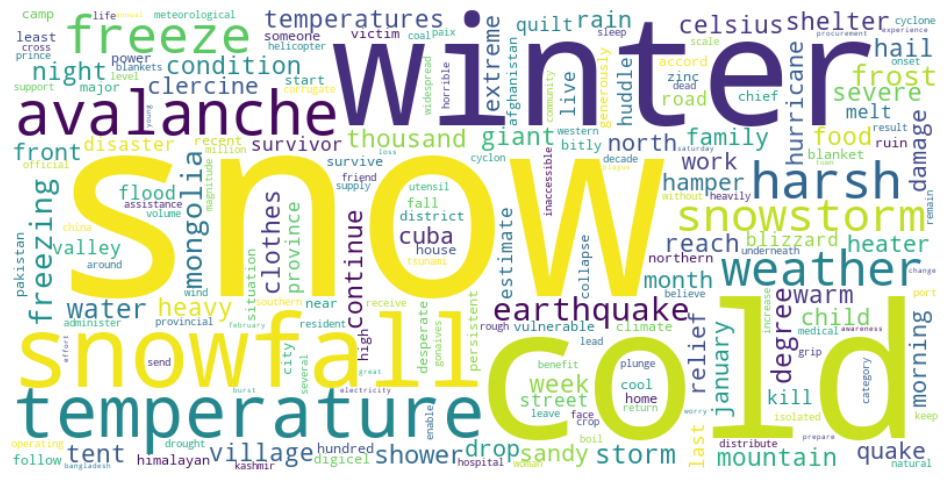

In [ ]:
# Generate feature importance plot
importances = model.feature_importances_
indices = np.argsort(importances)[::-1]
features = vectorizer.get_feature_names_out()
# Generate a dictionary with words and their importances
word_importances = {}
for i in range(len(indices)):
    word_importances[features[indices[i]]] = importances[indices[i]]

# Create the wordcloud
wordcloud = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(word_importances)

# Display the wordcloud
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

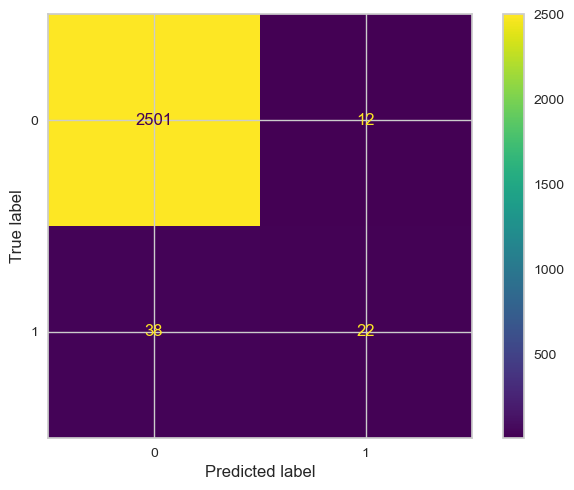

In [ ]:
# Obtain the confusion matrix
cm = confusion_matrix(y_val, pred_val)

# Uncomment the following line to just print the matrix to the standard output
# print(cm)

cm_display = ConfusionMatrixDisplay(cm) # Initiate a ConfusionMatrixDisplay object
cm_display.plot() # Plot the object
plt.show() # Display the plot

**3. Decision tree**

In [ ]:
# from sklearn.tree import DecisionTreeClassifier # Decision Tree Model for Classification

In [ ]:
# # Define the vectorizer with your desired parameters
# vectorizer = CountVectorizer()
# # Fit the vectorizer to the training data
# vectorizer.fit(df_train["message_cleaned"])
# # Transform the text for each data split and store it in a variable
# X_train = vectorizer.transform(df_train["message_cleaned"]).toarray()


In [ ]:
# # Load the model
# dt_model = DecisionTreeClassifier()

In [ ]:
# # Fit the model
# dt_model.fit(X=X_train, y=y_train)

In [ ]:
# # Obtain the predictions for the validation data
# pred_val = dt_model.predict(X_val)

In [ ]:
# # Get the classification report for the prediction
# # It is a dictionary that contains various metrics and their values
# # We choose accuracy and weighted average f1-score as our metrics of choice
# results = classification_report(y_true=y_val, y_pred=pred_val, output_dict=True, zero_division=0) # Use zero_devision to control warnings

In [ ]:
# print(f"Accuracy = {results['accuracy']*100:>.2f} %")
# print(f"Weighted Avg F1-score = {results['weighted avg']['f1-score']:>.4f}")


In general, a high feature importance value indicates that the feature is informative for the model and helps to improve the accuracy of the predictions. The model has learned that words in the cloud are important features for making accurate predictions. However, it does not necessarily mean that the feature has a strong positive or negative relationship with the outcome variable. It does not provide any information about the direction or strength of the relationship between "winter" and the outcome variable.

***VI. Prediction on K-means_Assign to clusters***

In [431]:
X_train = vectorizer.transform(df_train["message_cleaned"]).toarray()

In [443]:
X_train

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [484]:
X_train_vocab=vectorizer.vocabulary_

In [441]:
# Convert the cluster centers to a Pandas DataFrame
k = 36
cluster_centers_train = pd.DataFrame(km_train.cluster_centers_.T, columns=[f"cluster {i}" for i in range(k)])

In [466]:
cluster_centers_train

,cluster 0,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,cluster 8,cluster 9,...,cluster 26,cluster 27,cluster 28,cluster 29,cluster 30,cluster 31,cluster 32,cluster 33,cluster 34,cluster 35
0,0.0,0.000000,1.274723e-02,5.616357e-03,4.526158e-03,1.120794e-03,5.549814e-03,0.002603,8.501775e-03,-2.168404e-18,...,0.000000e+00,-4.336809e-19,4.336809e-19,2.209817e-03,3.998899e-03,1.379513e-02,-2.602085e-18,2.286381e-02,3.511147e-03,4.336809e-19
1,0.0,0.353301,-3.035766e-18,-2.602085e-18,3.380641e-03,5.982065e-04,1.098791e-03,0.002044,8.673617e-19,-4.336809e-19,...,3.010677e-03,-6.071532e-18,2.508295e-03,7.623495e-03,3.608309e-03,1.127695e-02,0.000000e+00,8.673617e-19,3.483689e-03,3.278678e-03
2,0.0,0.000000,3.469447e-18,3.469447e-18,2.289173e-03,-4.336809e-19,2.805264e-03,0.002644,-4.336809e-19,2.138265e-03,...,-4.336809e-19,6.938894e-18,-4.336809e-19,1.042504e-03,3.412618e-03,2.302486e-03,3.224277e-03,5.638544e-03,1.433760e-03,3.725389e-03
3,0.0,0.000000,-1.301043e-18,9.457979e-04,-4.770490e-18,1.170938e-17,-4.336809e-19,0.002692,1.084202e-18,1.084202e-18,...,1.301043e-18,-4.987330e-18,2.168404e-19,1.508726e-03,1.197651e-03,6.505213e-19,1.301043e-18,1.084202e-18,-5.854692e-18,4.336809e-19
4,0.0,0.000000,6.505213e-19,-6.505213e-19,8.673617e-18,-7.806256e-18,3.282376e-03,0.002216,8.673617e-19,2.168404e-18,...,8.673617e-19,3.035766e-18,-2.168404e-19,1.191664e-03,5.065631e-04,2.168404e-19,2.168404e-18,2.829216e-03,4.872077e-04,3.008546e-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.0,0.000000,7.589415e-19,1.409463e-18,4.987330e-18,-3.035766e-18,7.589415e-19,0.001114,0.000000e+00,1.084202e-19,...,0.000000e+00,3.252607e-18,1.084202e-19,1.572169e-03,7.589415e-19,0.000000e+00,-1.084202e-19,0.000000e+00,6.148446e-04,0.000000e+00
996,0.0,0.000000,8.673617e-19,-4.336809e-19,-6.722053e-18,-7.155734e-18,8.673617e-19,0.000452,0.000000e+00,4.093865e-03,...,2.168404e-19,-3.035766e-18,-4.336809e-19,-6.505213e-18,1.084202e-18,6.324977e-03,3.347210e-03,4.904509e-03,9.022357e-04,-4.336809e-19
997,0.0,0.000000,2.168404e-19,4.336809e-19,-2.385245e-18,1.883037e-03,5.094940e-03,0.001996,-1.734723e-18,4.654455e-03,...,2.239120e-03,2.602085e-18,4.582068e-03,4.689697e-04,3.033308e-03,-8.673617e-19,-1.951564e-18,6.993529e-03,1.732409e-03,1.437854e-02
998,0.0,0.000000,4.336809e-19,-2.168404e-19,4.228388e-18,4.987330e-18,6.505213e-19,0.001212,4.336809e-19,1.084202e-18,...,4.336809e-19,1.301043e-18,-1.084202e-19,4.445229e-18,6.505213e-19,6.559107e-03,1.084202e-18,4.336809e-19,7.467532e-04,-2.168404e-19


In [503]:
df_test['message_cleaned']

0       leogane destroy hospital croix function needs ...
1                     gressier assistance right away asap
2                                       delmas silo water
3                          police officer street insecure
4                                         driver mechanic
                              ...                        
2624    unhcr supply basic nonfood item sanitary mosqu...
2625    first organization respond midnovember outbrea...
2626    president government always believe democratic...
2627    following severe flood occur previous ircs bra...
2628    hpakant rich coveted jade stone recent influx ...
Name: message_cleaned, Length: 2629, dtype: object

In [505]:
def preprocess(words):
    # Lowercase and remove non-alphabetic characters
    words = [re.sub(r"[^a-z]+", "", word.lower()) for word in words]
    # Remove the first letter of each word
    words = [word[1:] for word in words]
    return words


In [711]:
# centroids = km_train.cluster_centers_

# Use data from testing set to give classify text to training clusters

In [724]:
new_phrase=dict_test_cluster['Cluster 3'][9]
# Preprocess the new phrase
new_phrase_vec = vectorizer.transform([new_phrase])
# Predict the cluster for the new phrase
predicted_cluster = km_train.predict(new_phrase_vec)
print("'"+str(new_phrase)+"'", " belong to cluster "+ str(predicted_cluster[0]))

'earthquake everywhere'  belong to cluster 5


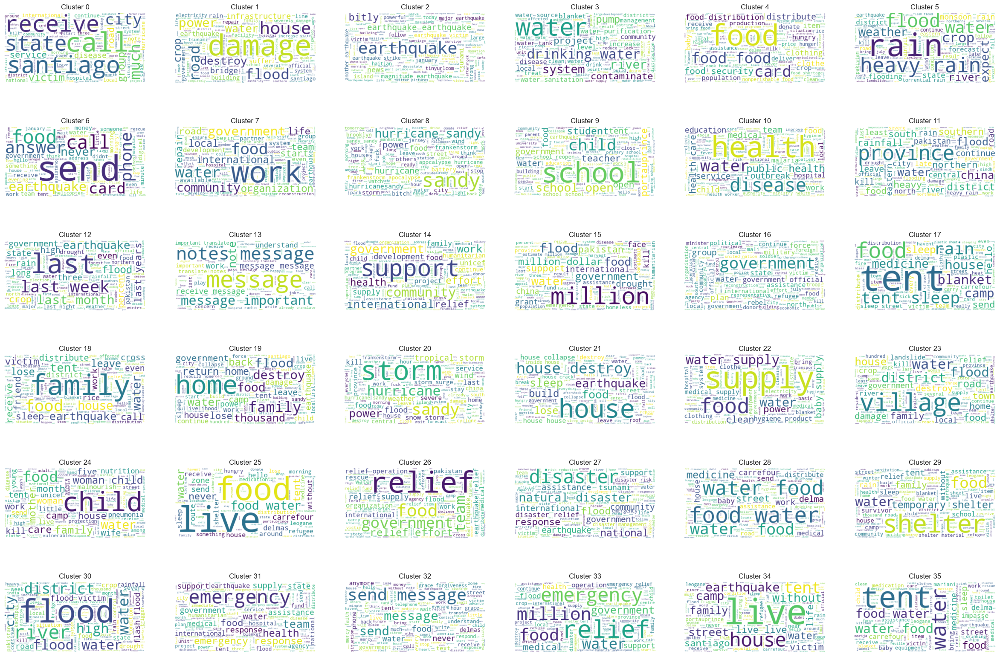

In [717]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# create the figure and subplots
fig, axs = plt.subplots(6, 6, figsize=(30, 20))

# plot word clouds for all subplots
for i, ax in enumerate(axs.flatten()):
    if i < 36:
        text = ' '.join(dict_train_cluster[f'Cluster {i}'])
        wordcloud = WordCloud(background_color="white").generate(text)
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.axis("off")
        ax.set_title(f'Cluster {i}')
    else:
        ax.axis("off")

# adjust spacing between subplots
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# display the plot
plt.show()


***VII. Sentiment analysis***

In [ ]:
pipeline = make_pipeline(vectorizer, model) # apply pipleline method to use the TF-ID approach to the prediction model

In [ ]:
class_names = ['negative', 'positive'] # assign prediction model class (negative and positive)
explainer = LimeTextExplainer(class_names=class_names) # use LIME explainer method to explain the prediction classes

In [ ]:
ind = 3 # assign the test index
text = X_test[ind] # assign the X_test data for index 03
print(text)

[0. 0. 0. ... 0. 0. 0.]


In [ ]:
# exp = explainer.explain_instance(text, pipeline.predict_proba, num_features=6) # use the explainer method for the text data for the prediction model showing six features
# exp.show_in_notebook(text=True) # show the 

***VIII. MODEL SELECTION FOR TEXT CLASSIFICATION: (LOGISTIC REGRESSION, SVM, DECISION TREES, CNNs, RNNs, etc)***

**IX. TRAINING AND VALIDATION**

**X. TESTING**

**XI. DEPLOYMENT**